# Предсказание стартапов

## Описание проекта

Главная задача - разработать модель для предсказания успешности стартапа (закроется или нет).

Работа будет проводится с псевдо-реальными (реальные данные в которые добавлена синтетическая составляющая) данными о стартапах, функционировавших в период с 1970 по 2018 годы.

Выделены следующие этапы работы:

- загрузка и ознакомление с данными,
- предварительная обработка,
- полноценный разведочный анализ,
- разработка новых синтетических признаков,
- проверка на мультиколлинеарность,
- отбор финального набора обучающих признаков,
- выбор и обучение моделей,
- итоговая оценка качества предсказания лучшей модели,
- анализ важности ее признаков,
- подготовка отчета по исследованию.

## Первоначальная настройка

### Автоматическая перезагрузка всех модулей

In [1]:
# загрузка расширения autoreload
%load_ext autoreload

# автоматическая перезагрузка всех модулей
%autoreload 2

### Установка всех необходимых пакетов

In [2]:
# для определения правильности написания стран
!pip install pycountry -q

# для определения правильности написания штатов
!pip install us -q

# для определения широты и долготы городов
!pip install geopy -q

### Подключение всех необходимых библиотек

In [3]:
# для взаимодействия с операционной системой
import os

# для работы с регулярными выражениями
import re

# для работы со временем
import time

# для управления предупреждениями
import warnings

# для подсчета частоты категорий
from collections import Counter

# для работы с векторами, матрицами и многомерными массивами
import numpy as np

# для работы с данными
import pandas as pd

# для статистических вычислений
import scipy.stats as pt

# для визуализации данных
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff

# для разделения данных и поиска гиперпараметров
from sklearn.model_selection import (train_test_split, cross_val_score,
                                     StratifiedKFold)

# для построения пайплайнов и трансформеров
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

# для кодирования категориальных данных и нормализации числовых данных
from sklearn.preprocessing import (OneHotEncoder, OrdinalEncoder,
                                   LabelEncoder, StandardScaler,
                                   MinMaxScaler, RobustScaler)

# для заполнения пропущенных значений
from sklearn.impute import SimpleImputer

# для векторизации текста
from sklearn.decomposition import PCA
from sklearn.feature_extraction.text import TfidfVectorizer

# для устранение дисбаланса классов
from imblearn.over_sampling import SMOTE

# модели машинного обучения
from sklearn.linear_model import (LogisticRegression, LinearRegression,
                                  Ridge, Lasso, RidgeClassifier)
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor

# для градиентного бустинга
import lightgbm as lgb
from catboost import CatBoostClassifier

# метрики оценки качества моделей
from sklearn.metrics import (confusion_matrix, accuracy_score,
                             precision_score, recall_score,
                             precision_recall_curve, roc_auc_score,
                             make_scorer, r2_score, mean_squared_error,
                             mean_absolute_error, f1_score)

# dummy модели
from sklearn.dummy import DummyClassifier

# для вычисления коэффициента VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor

# для визуализации пропущенных данных
import missingno as msno

# для автоматического подбора гиперпараметров
import optuna
from optuna.integration import OptunaSearchCV
from optuna.distributions import (CategoricalDistribution, FloatDistribution,
                                  IntDistribution)

# для объяснения предсказаний
import shap

# для отображения контента в jupyter notebook
from IPython.display import Markdown

# для работы с кодами стран и их регионов
import pycountry

# для работы с кодами штатов
import us

# для получение широты и долготы городов
from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut

### Задание всех необходимых опций

In [4]:
# настройка pandas для отображения всех столбцов и строк
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# установка палитры
sns.set_palette('muted')

# создание констант для
# воспроизводимости результатов
RANDOM_STATE = 42

# объект геокодера
geolocator = Nominatim(user_agent='geoapi', timeout=10)

# подавление предупреждений
warnings.filterwarnings('ignore', category=optuna.exceptions.ExperimentalWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

# установить уровень логирования на WARNING,
# чтобы уменьшить количество выводимой информации
optuna.logging.set_verbosity(optuna.logging.WARNING)

# подавление всех предупреждений
# warnings.filterwarnings('ignore')

### Функции

#### `create_dataframe()`

In [5]:
def create_dataframe(pth1, pth2='', sep=',', decimal='.', encoding='utf-8'):
    '''
    Функция возвращает датафрейм по заданным путям pth1
    и pth2 к датасету.
    
    Аргументы функции: 
    - pth1: путь к датасету (строка),
    - pth2: альтернативный путь
      к датасету (строка),
    - sep: разделитель столбцов (строка),
    - decimal: десятичный разделитель (строка).
    '''
    if os.path.exists(pth1):      
        return pd.read_csv(pth1, sep=sep, decimal=decimal, encoding=encoding)
    elif os.path.exists(pth2):
        return pd.read_csv(pth2, sep=sep, decimal=decimal, encoding=encoding)
    else:
        print('Ошибка чтения')

#### `data_review()`

In [6]:
def data_review(df):
    '''
    Функция выводит информацию
    о заданном датафрейме df.
    
    Аргументы функции:
    - df: заданный датафрейм.
    '''
    # вывод первых пяти строк данных
    display(Markdown('##### Первые 5 строк датасета'))
    display(df.head())
    
    # вывод информации о столбцах и типах данных
    display(Markdown('##### Информация о столбцах и типах данных'))
    print(df.info())
    
    # вывод статистического описания
    display(Markdown('##### Статистическое описание'))
    display(df.describe(include='all'))

#### `change_data_types()`

In [7]:
def change_data_types(df, column_types):
    '''
    Функция изменяет типы данных столбцов выбранного
    датафрейма df согласно заданному словарю column_types.
    
    Аргументы функции:
    - df: выбранный датафрейм,
    - column_types: заданный словарь
      (ключ - название столбца,
       значение - нужный тип данных).
    '''
    # изменение типов данных столбцов
    for col, col_type in column_types.items():
        try:
            if col_type == 'datetime':
                df[col] = pd.to_datetime(df[col], format='%Y-%m-%d')
            else:
                df[col] = df[col].astype(col_type)
        except ValueError:
            print(f'Ошибка преобразования столбца "{col}" в тип {col_type}')
        except KeyError:
            print(f'Столбец "{col}" отсутствует в DataFrame')
    
    # проверка
    print(df.dtypes)
    
    # возвращение заданного датафрейма
    return df

#### `fill_nan()`

In [8]:
def fill_nan(df, fillna_pipeline=None, num_cols=[], cat_cols=[], obj_cols=[]):
    '''
    Функция заполняет пропущенные значения в заданном
    датафрейме, возвращая его измененную копию и пайплайн.
    
    Аргументы функции:
    - df: заданный датафрейм,
    - fillna_pipeline: пайплайн по заполнению
    пропущенных значений,
    - num_cols: числовые столбцы (список),
    - cat_cols: категориальные столбцы (список),
    - obj_cols: текстовые столбцы (список).
    '''
    # проверка на наличие всех необходимых столбцов в датафрейме
    missing_num_cols = [col for col in num_cols if col not in df.columns]
    missing_cat_cols = [col for col in cat_cols if col not in df.columns]
    missing_obj_cols = [col for col in obj_cols if col not in df.columns]
    
    # добавление отсутствующих столбцов
    for col in missing_num_cols:
        df[col] = np.nan
    for col in missing_cat_cols:
        df[col] = np.nan
    for col in missing_obj_cols:
        df[col] = np.nan
    
    if fillna_pipeline is None:
        
        # создание пайплайна по заполнению пропущенных значений
        fillna_pipeline = ColumnTransformer(
            [
                (
                    'num',
                    SimpleImputer(missing_values=np.nan, strategy='median'),
                    num_cols
                ),
                (
                    'cat',
                    SimpleImputer(missing_values=np.nan, strategy='constant', fill_value='unknown'),
                    cat_cols
                ),
                (
                    'obj',
                    SimpleImputer(missing_values=np.nan, strategy='constant', fill_value='unknown'),
                    obj_cols
                )
            ],
            remainder='passthrough'
        )
        
        # заполнение пропущенных значений
        df_np = fillna_pipeline.fit_transform(df)
    
    else:
        
        # заполнение пропущенных значений
        df_np = fillna_pipeline.transform(df)
        
    # получение имен столбцов, которые прошли через remainder='passthrough'
    passthrough_cols = [col for col in df.columns if col not in num_cols + cat_cols + obj_cols]
    
    # объединение всех имен столбцов
    all_cols = num_cols + cat_cols + obj_cols + passthrough_cols
    
    # преобразование обратно в датафрейм
    df_filled = pd.DataFrame(df_np, columns=all_cols)
    
    # восстановление типов данных
    for col in num_cols:
        df_filled[col] = df_filled[col].astype(df[col].dtype)
    for col in cat_cols:
        df_filled[col] = df_filled[col].astype('category')
        if 'unknown' not in df_filled[col].cat.categories:
            df_filled[col] = df_filled[col].cat.add_categories(['unknown'])
    for col in obj_cols:
        df_filled[col] = df_filled[col].astype(df[col].dtype)
    
    # восстановление исходного порядка столбцов
    df_filled = df_filled[df.columns]
    
    # удаление временно добавленных столбцов
    df_filled.drop(
        columns=missing_num_cols + missing_cat_cols + missing_obj_cols,
        inplace=True
    )
    
    # возвращение датафрейма и пайплайна
    return df_filled, fillna_pipeline

#### `cat_unique()`

In [9]:
def cat_unique(df):
    '''
    Функция выводит топ-30 уникальных значений по столбцам
    типа category заданного датафрейма df.
    
    Аргументы функции:
    - df: заданный датафрейм.
    '''
    for column in df.select_dtypes(include=['category']).columns:
        print(f'\nТоп-50 значений для столбца: {column}\n{"-"*50}')
        
        try:
            # подсчет количества вхождений уникальных значений
            category_counts = df[column].value_counts().head(30)

            # преобразование в DataFrame для удобства
            category_counts_df = category_counts.reset_index()
            category_counts_df.columns = ['category', 'frequency']

            # вывод результата
            display(category_counts_df)

        except Exception as e:
            print(f'Ошибка при обработке столбца {column}: {e}')

#### `categorize()`

In [10]:
def categorize(row):
    '''
    Функция укрупняет категории.
    '''
    # словарь для выделения более крупных категорий
    category_mapping = {
        # IT
        'Software': 'IT',
        'Mobile': 'IT',
        'Enterprise Software': 'IT',
        'Analytics': 'IT',
        'Hardware': 'IT',
        'Hardware + Software': 'IT',
        'Cloud-Based Music': 'IT',
        'Cloud Computing': 'IT',
        'Communications Hardware': 'IT',
        'SaaS': 'IT',
        'Apps': 'IT',
        'Facebook Applications': 'IT',
        'Big Data': 'IT',
        'Big Data Analytics': 'IT',
        'Web Hosting': 'IT',
        'Web Development': 'IT',
        'Android': 'IT',
        'iOS': 'IT',
        'CRM': 'IT',
        'Information Technology': 'IT',
        'Health Care Information Technology': 'IT',
        'IT': 'IT',
        # медицина
        'Biotechnology': 'Medicine',
        'Health Care': 'Medicine',
        'Health Diagnostics': 'Medicine',
        'Medical': 'Medicine',
        'Medical Devices': 'Medicine',
        'Quantified Self': 'Medicine',
        'Health and Wellness': 'Medicine',
        'Pharmaceuticals': 'Medicine',
        'Medicine': 'Medicine',
        # медиа
        'Curated Web': 'Media',
        'Social Media': 'Media',
        'Advertising': 'Media',
        'Video': 'Media',
        'Video Streaming': 'Media',
        'Music': 'Media',
        'Photography': 'Media',
        'News': 'Media',
        'Social Network Media': 'Media',
        'Search': 'Media',
        'Networking': 'Media',
        'Messaging': 'Media',
        'Digital Media': 'Media',
        'Content': 'Media',
        'Publishing': 'Media',
        'Reviews and Recommendations': 'Media',
        'Public Relations': 'Media',
        'Media': 'Media',
        # продажи
        'E-Commerce': 'Sales',
        'Mobile Commerce': 'Sales',
        'Social Commerce': 'Sales',
        'Retail': 'Sales',
        'Marketplaces': 'Sales',
        'Online Shopping': 'Sales',
        'Sales and Marketing': 'Sales',
        'Brand Marketing': 'Sales',
        'Internet Marketing': 'Sales',
        'Sales': 'Sales',
        # развлечения
        'Games': 'Entertainment',
        'Sports': 'Entertainment',
        'Events': 'Entertainment',
        'Entertainment': 'Entertainment',
        # энергетика
        'Clean Technology': 'Energy',
        'Electric Vehicles': 'Energy',
        'Energy': 'Energy',
        # финансы
        'Financial Services': 'Finance',
        'FinTech': 'Finance',
        'Payments': 'Finance',
        'Finance': 'Finance',
        # путешествия
        'Transportation': 'Travel',
        'Travel': 'Travel',
        # услуги
        'Consulting': 'Services',
        'Location Based Services': 'Services',
        'Service Providers': 'Services',
        'Customer Services': 'Services',
        'Services': 'Services',
        # недвижимость
        'Hospitality': 'Real Estate',
        'Real Estate': 'Real Estate',
        # мода
        'Fashion': 'Fashion',
        # фитнес
        'Fitness': 'Fitness',
        # образование
        'Education': 'Education',
        # дизайн
        'Design': 'Design',
        # промышленность
        'Manufacturing': 'Industry',
        'Semiconductors': 'Industry',
        'Automotive': 'Industry',
        'Industry': 'Industry',
        # еда
        'Restaurants': 'Food',
        'Food': 'Food',
        # безопасность
        'Security': 'Security',
        # коллаборация
        'Collaboration': 'Collaboration',
        # HR
        'Recruiting': 'HR',
        'Human Resources': 'HR',
        'HR': 'HR',
        # технологии
        'Internet': 'Technology',
        'Internet of Things': 'Technology',
        'Telecommunications': 'Technology',
        'EdTech': 'Technology',
        'Wireless': 'Technology',
        'iPhone': 'Technology',
        'Technology': 'Technology',
        # потребительское
        'Consumer Goods': 'Consumer',
        'Consumer Electronics': 'Consumer',
        'Consumer': 'Consumer',
        # бизнес
        'Startups': 'Business',
        'Business Services': 'Business',
        'Business Intelligence': 'Business',
        'Enterprises': 'Business',
        'B2B': 'Business',
        'Crowdsourcing': 'Business',
        'Small and Medium Businesses': 'Business',
        'Business': 'Business',
        # настоящее время
        'Real Time': 'Real Time',
        # образ жизни
        'Lifestyle': 'Lifestyle',
        # неизвестное
        'unknown': 'unknown',
        # разное
        'Other': 'Other'
    }

    # укрупнение категорий
    categories = row.split('|') if pd.notna(row) else []
    main_groups = set()
    for cat in categories:
        if cat in category_mapping:
            main_groups.add(category_mapping[cat])
    
    # возвращение категории
    return '|'.join(sorted(main_groups)) if main_groups else 'Other'

#### `check_abbr()`

In [11]:
def check_abbr(df, col, valid):
    '''
    Функция выводит кол-во некорректных аббревиатур
    в выбранном столбце заданного датафрейма, при этом
    заменяя некорректные значения на 'unknown'. Также
    выводятся все уникальные значения.
    
    Аргументы функции:
    - df: заданный датафрейм,
    - col: выбранный столбец,
    - valid: список корректных значений.
    '''
    # определение некорректных значений
    invalid_mask = ~df[col].isin(valid)
    invalid_count = invalid_mask.sum()
    
    # замена некорректных значений на 'unknown'
    df[col] = df[col].apply(
        lambda x: x if x in valid else 'unknown'
    )
    
    # проверка
    print(f'Встречено {invalid_count} некорректных аббревиатур\n')
    print('Уникальные значения:')
    print(df[col].unique())

#### `obvious_duplicates()`

In [12]:
def obvious_duplicates(df, comb_cols=[]):
    '''
    Функция выводит количество явных дубликатов.
    
    Аргументы функции:
    - df: заданный датафрейм,
    - comb_cols: комбинации столбцов,
      по которым нужно проверить наличие
      явных дубликатов (двумерный список).
    '''
    # вывод столбцов и кол-ва дубликатов,
    # находящихся в этих столбцах
    for column in df.columns:
        print(f'{column}: {df.duplicated(subset=column).sum()}')
    
    # отступ
    if comb_cols != []:
        print()
    
    # кол-во дубликатов по комбинациям столбцов
    for column in comb_cols:
        print(f'{column}: {df.duplicated(subset=column).sum()}')
    
    # вывод кол-ва явных дубликатов всего датафрейма
    print(f'\nкол-во абсолютных явных дубликатов: {df.duplicated().sum()}')

#### `more_describe()`

In [13]:
def more_describe(df, col=None, hue=None):
    '''
    Функция выводит расширенное статистическое описание
    заданного числового столбца выбранного датафрейма.
    
    Аргументы функции:
    - df: выбранный датафрейм,
    - column: заданный числовой столбец (строка),
    - hue: дополнительная разбивка (строка).
    '''
    if hue is not None:
        
        description = pd.DataFrame(columns=df[hue].unique())
        
        # перебор по категориям
        for category in df[hue].unique():
            
            # фильтрация данных по категории
            category_data = df[df[hue] == category]
            
            # получение стандартного описания
            description[category] = category_data[col].describe()
            
            # вычисление квартилей и межквартильного размаха
            # для каждой категории
            q1 = category_data[col].quantile(q=0.25)
            q3 = category_data[col].quantile(q=0.75)
            iqr = q3 - q1
            
            # определение выбросов
            ems = ((category_data[col] < (q1 - 1.5 * iqr)) | 
                   (category_data[col] > (q3 + 1.5 * iqr)))
            
            # подсчет выбросов и их характеристик
            count = category_data[ems].shape[0]
            share = count / category_data[col].count() * 100
            min_em = category_data[ems][col].min()
            max_em = category_data[ems][col].max()
            
            # подготовка результатов
            description.loc['iqr', category] = iqr
            description.loc['lower_bound', category] = q1
            description.loc['upper_bound', category] = q3
            description.loc['outliers_count', category] = count
            description.loc['outliers_pct', category] = share
            description.loc['outlier_min', category] = min_em
            description.loc['outlier_max', category] = max_em
    
    else:
        
        if col is not None:
            
            # получение стандартного описания
            description = df[col].describe()
            
            # вычисление квартилей и межквартильного размаха
            q1 = df[col].quantile(q=0.25)
            q3 = df[col].quantile(q=0.75)
            iqr = q3 - q1
            
            # определение выбросов
            ems = ((df[col] < (q1-1.5*iqr)) |\
                   (df[col] > (q3+1.5*iqr)))
            
            # подсчет выбросов и их характеристик
            count = df[ems][col].count()
            share = count / df[col].count() * 100
            min_em = df[ems][col].min()
            max_em = df[ems][col].max()
            
        else:
            
            # получение стандартного описания
            description = df.describe()
            
            # вычисление квартилей и межквартильного размаха
            q1 = df.quantile(q=0.25)
            q3 = df.quantile(q=0.75)
            iqr = q3 - q1
            
            # определение выбросов
            ems = ((df < (q1-1.5*iqr)) |\
                   (df > (q3+1.5*iqr)))
            
            # подсчет выбросов и их характеристик
            count = df[ems].count()
            share = count / df.count() * 100
            min_em = df[ems].min()
            max_em = df[ems].max()
        
        # подготовка результатов
        description['iqr'] = iqr
        description['lower_bound'] = q1
        description['upper_bound'] = q3
        description['outliers_count'] = count
        description['outliers_pct'] = share
        description['outliers_min'] = min_em
        description['outliers_max'] = max_em
    
    return description

#### `box_plots()`

In [14]:
def box_plots(df, t=''):
    '''
    Функция составляет график ящиков с усами для всех числовых столбцов
    заданного датафрейма df.
    
    Аргументы функции:
    - df: заданный датафрейм,
    - t: название графика (строка).
    '''
    # выбор числовых столбцов
    numerical_df = df.select_dtypes(include='number')
    
    # преобразование DataFrame в long format
    df_long = numerical_df.melt(var_name='столбец', value_name='значение')
    
    # построение ящиков с усами
    plt.figure(figsize=(15, 10))
    sns.boxplot(data=df_long, x='столбец', y='значение')
    
    # создание подписей над осями графика
    plt.xlabel('столбец', labelpad=15, fontsize=12)
    plt.ylabel('значение', labelpad=15, fontsize=12)
    
    # заголовок
    plt.title(t, pad=10, fontsize=18)
    
    # отображение графика
    plt.show()

#### `tree_map()`

In [15]:
def tree_map(df, cat, subcat=None, subsubcat=None, t='', l=None, figsize=(1800, 1000)):
    '''
    Функция составляет treemap по заданному DataFrame.

    Аргументы функции:
    - df: DataFrame,
    - cat: столбец с родительскими категориями,
    - subcat: столбец с дочерними категориями (необязательно),
    - subsubcat: столбец с поддочерними категориями (необязательно),
    - t: название графика,
    - l: словарь подписей осей,
    - figsize: размер графика.
    '''
    # преобразование категориальных столбцов в строки (object), чтобы ускорить groupby
    df_temp = df.copy()
    columns_to_convert = [col for col in [cat, subcat, subsubcat] if col is not None]
    for col in columns_to_convert:
        df_temp[col] = df_temp[col].astype(str)

    # группировка
    if subsubcat is not None and subcat is not None:
        frequency = df_temp.groupby([cat, subcat, subsubcat], observed=False).size().reset_index(name='count')
        path = [cat, subcat, subsubcat]
    elif subcat is not None:
        frequency = df_temp.groupby([cat, subcat], observed=False).size().reset_index(name='count')
        path = [cat, subcat]
    else:
        frequency = df_temp[cat].value_counts().reset_index()
        frequency.columns = [cat, 'count']
        path = [cat]

    # вычисление процентов
    frequency['percent'] = (frequency['count'] / frequency['count'].sum()) * 100

    # построение treemap
    fig = px.treemap(
        frequency, 
        path=path, 
        values='count', 
        title=t,
        labels=l,
        hover_data={'percent': ':.2f'}
    )

    # задание размеров графика
    fig.update_layout(width=figsize[0], height=figsize[1])

    # отображение графика
    fig.show()

#### `hist_plot()`

In [16]:
def hist_plot(df, x=None, hue=None, bins=None, xlim=None, xl='', yl='', lt='', t='', figsize=(1800, 800)):
    '''
    Функция строит гистограмму с ящиком с усами (box plot)
    и разбивкой по целевому категориальному признаку.

    Аргументы функции:
    - df: DataFrame с данными,
    - x: столбец с значениями по оси X,
    - hue: дополнительная разбивка,
    - bins: кол-во корзин,
    - xlim: диапазон по оси X,
    - xl: подпись оси X,
    - yl: подпись оси Y,
    - lt: заголовок легенды,
    - t: заголовок графика,
    - figsize: размер графика.
    '''
    # построение гистограммы
    fig = px.histogram(
        df,
        x=x,
        color=hue,
        nbins=bins,
        range_x=xlim,
        marginal='box',
        opacity=0.5,
        barmode='group',
        title=t
    )

    if hue is not None:
        
        # заголовок легенды
        fig.update_layout(legend_title_text=lt)
        
    # названия осей
    fig.update_layout(
        xaxis_title=xl,
        yaxis_title=yl
    )
    
    # подписи при наведении
    fig.update_traces(
        hovertemplate='Значение: %{x}<br>Частота: %{y}<br>'
    )
    
    # задание размеров графика
    fig.update_layout(width=figsize[0], height=figsize[1])
    
    # отображение графика
    fig.show()

#### `pie_plot()`

In [17]:
def pie_plot(df, col, lt='', t='', figsize=(1800, 800)):
    '''
    Функция составляет круговую диаграмму
    по заданному датафрейму.
    
    Аргументы функции:
    - df: заданный датафрейм,
    - col: столбец с категор. значениями (строка),
    - lt: название легенды (строка),
    - t: название графика (строка),
    - figsize: размер графика.
    '''
    # построение круговой диаграммы
    fig = px.pie(
        df, 
        names=col,
        title=t
    )
    
    # заголовок легенды
    fig.update_layout(legend_title_text=lt)
    
    # подписи при наведении
    fig.update_traces(
        textinfo='percent+label',
        hovertemplate='Категория: %{label}<br>Частота: %{value}<br>Процент: %{percent}'
    )
    
    # задание размеров графика
    fig.update_layout(width=figsize[0], height=figsize[1])
    
    # отображение графика
    fig.show()

#### `vif_heatmap()`

In [18]:
def vif_heatmap(df, t='', figsize=(1800, 800)):
    '''
    Функция создает тепловую карту на основе коэффициента VIF.

    Аргументы:
    - df: датафрейм с числовыми признаками (без категориальных),
    - t: название графика,
    - figsize: размер графика.
    '''
    # вычисление VIF для каждого признака
    vif_data = pd.DataFrame()
    vif_data['feature'] = df.columns
    vif_data['vif'] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]

    # создание DataFrame для тепловой карты
    vif_matrix = pd.DataFrame(np.diag(vif_data['vif']), index=df.columns, columns=df.columns)

    # создание тепловой карты VIF
    fig = px.imshow(
        vif_matrix,
        color_continuous_scale='Reds',
        title=t
    )

    # изменение размеров графика
    fig.update_layout(width=figsize[0], height=figsize[1])

    # отображение графика
    fig.show()

#### `get_lat_lon()`

In [19]:
# кэш для хранения координат
city_cache = {}

def get_lat_lon(city):
    '''
    Функция получает широту и долготу города, используя кэш.
    '''
    # пропуск NaN
    if pd.isna(city):
        return None, None
    
    # проверка есть ли город в кэше
    if city in city_cache:
        return city_cache[city]

    # получение координат
    try:
        location = geolocator.geocode(city)
        if location:
            city_cache[city] = (location.latitude, location.longitude)
            return location.latitude, location.longitude
        else:
            return None, None
    except GeocoderTimedOut:
        return None, None

#### `get_coords_city()`

In [20]:
def get_coords_city(df, col, path_to_save):
    '''
    Функция получает щироту и долготу каждого города,
    находящегося в выбранном датафрейме df заданного столбца col.

    Аргументы функции:
    - df: выбранный датафрейм,
    - col: заданный столбец, в котором находятся города,
    - path_to_save: путь к сохранению результатов.
    '''
    # получение уникальных городов
    unique_cities = df[col].dropna().unique()
    
    # запрос координат только для уникальных городов
    city_coords = {city: get_lat_lon(city) for city in unique_cities}
    
    # применение к датафрейму
    df[['latitude', 'longitude']] = df[col].map(city_coords).apply(pd.Series)
    
    # сохранение результатов
    df.to_csv(path_to_save, index=False)
    
    # проверка
    df[[col, 'latitude', 'longitude']].head(10)

#### `train_val_best_model()`

In [21]:
def train_val_best_model(pipe, X_tr, y_tr, X_va, y_va):
    '''
    Функция проводит кросс-валидацию с помощью Optuna
    и возвращает его объект.
    
    Аргументы функции:
    - pipe: заданный пайплайн,
    - X_tr: входные признаки тренировочной выборки,
    - y_tr: целевой признак тренировочной выборки,
    - X_va: входные признаки валидационной выборки,
    - y_va: целевой признак валидационной выборки.
    '''
    # обучение
    strart_train_time = time.time()
    pipe.fit(X_tr, y_tr)
    train_time = round(time.time() - strart_train_time, 2)
    
    # предсказание на валидационной выборке
    strart_pred_time = time.time()
    y_pred = pipe.predict(X_va)
    pred_speed = round(len(X_va) / (time.time() - strart_pred_time), 2)
    
    # вычисление вероятностей
    y_pred_proba = pipe.predict_proba(X_va)[:,1]
    
    # вычисление F1-score
    f1 = f1_score(y_va, y_pred)
    
    # вывод метрик
    print(f'F1-score на валидации: {f1:.4f}')
    print(f'Время обучения: {train_time} сек.')
    print(f'Скорость предсказания: {pred_speed} предск./сек.')

    # возвращение результатов
    return pipe, y_pred, y_pred_proba

#### `standard_metrics()`

In [22]:
def standard_metrics(task, y_true, y_pred):
    '''
    Функция вычисляет стандартные метрики
    в зависимости от типа задачи по заданным
    истинным и предсказанным значениям.
    
    Аргументы функции:
    - task: тип задачи ('regr' или 'class'),
    - y_true: истинные значения,
    - y_pred: предсказанные значения.
    '''
    # метрики для задачи регрессии
    if task == 'regr':
        
        # метрика R^2
        r2 = r2_score(y_true, y_pred)
        
        # метрика MSE
        mse = mean_squared_error(y_true, y_pred)
        
        # метрика RMSE
        rmse = np.sqrt(mse)
        
        # метрика MAE
        mae = mean_absolute_error(y_true, y_pred)
        
        # вывод
        print(f'R^2 = {round(r2, 3)}')
        print(f'MSE = {round(mse, 3)}')
        print(f'RMSE = {round(rmse, 3)}')
        print(f'MAE = {round(mae, 3)}')
        
    # метрики для задачи классификации
    elif task == 'class':
        
        # метрика accuracy
        accuracy = accuracy_score(y_true, y_pred)
        
        # вычисление метрики precision
        precision = precision_score(y_true, y_pred)
        
        # вычисление метрики recall
        recall = recall_score(y_true, y_pred)
        
        # вывод
        print(f'accuracy = {int(round(accuracy, 2) * 100)}%')
        print(f'precision = {int(round(precision, 2) * 100)}%')
        print(f'recall = {int(round(recall, 2) * 100)}%')

#### `conf_matrix()`

In [23]:
def conf_matrix(y_tr, y_pr, le=None, t='', figsize=(800, 800)):
    '''
    Функция создает интерактивную матрицу ошибок.
    
    Аргументы функции:
    - y_tr: истинные значения,
    - y_pr: предсказанные значения,
    - le: кодировщик целевого признака LabelEncoder (если есть),
    - t: название матрицы ошибок,
    - figsize: размер графика.
    '''
    # создание матрицы ошибок
    cm = confusion_matrix(y_tr, y_pr)

    # определение меток классов
    labels = le.classes_ if le is not None else np.unique(y_tr)
    labels = list(map(str, labels))
    
    # создание аннотированной тепловой карты
    fig = ff.create_annotated_heatmap(
        z=cm,
        x=labels,
        y=labels,
        colorscale='Blues',
        showscale=True
    )
    
    # настройки графика
    fig.update_layout(
        title=t,
        xaxis=dict(
            title='Прогнозы',
            title_standoff=20,
            side='bottom',
            tickmode='array'
        ),
        yaxis=dict(title='Истина'),
        width=figsize[0],
        height=figsize[1]
    )

    # отображение графика
    fig.show()

## Загрузка данных

### Тренировочный датасет

In [24]:
# создание датафрейма
startups_train = create_dataframe('datasets/kaggle_startups_train_28062024.csv')

# обзор данных
data_review(startups_train)

##### Первые 5 строк датасета

,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at,closed_at
0,Lunchgate,Online Reservations|Restaurants,828626.0,operating,CHE,25,Zurich,Zürich,2,2009-10-17,2011-05-01,2014-12-01,NaN
1,EarLens,Manufacturing|Medical|Medical Devices,42935019.0,operating,USA,CA,SF Bay Area,Redwood City,4,2005-01-01,2010-05-04,2014-02-25,NaN
2,Reviva Pharmaceuticals,Biotechnology,35456381.0,operating,USA,CA,SF Bay Area,San Jose,3,2006-01-01,2012-08-20,2014-07-02,NaN
3,Sancilio and Company,Health Care,22250000.0,operating,NaN,NaN,NaN,NaN,3,2004-01-01,2011-09-01,2014-07-18,NaN
4,WireTough Cylinders,Manufacturing,NaN,operating,USA,VA,VA - Other,Bristol,1,2010-05-12,2012-02-01,2012-02-01,NaN


##### Информация о столбцах и типах данных

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52516 entries, 0 to 52515
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               52515 non-null  object 
 1   category_list      50051 non-null  object 
 2   funding_total_usd  42447 non-null  float64
 3   status             52516 non-null  object 
 4   country_code       47014 non-null  object 
 5   state_code         45753 non-null  object 
 6   region             46157 non-null  object 
 7   city               46157 non-null  object 
 8   funding_rounds     52516 non-null  int64  
 9   founded_at         52516 non-null  object 
 10  first_funding_at   52516 non-null  object 
 11  last_funding_at    52516 non-null  object 
 12  closed_at          4917 non-null   object 
dtypes: float64(1), int64(1), object(11)
memory usage: 5.2+ MB
None


##### Статистическое описание

,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,founded_at,first_funding_at,last_funding_at,closed_at
count,52515,50051,4.244700e+04,52516,47014,45753,46157,46157,52516.000000,52516,52516,52516,4917
unique,52515,22105,NaN,2,134,300,1036,4477,NaN,5402,4603,4305,3008
top,Lunchgate,Software,NaN,operating,USA,CA,SF Bay Area,San Francisco,NaN,2012-01-01,2013-01-01,2014-01-01,2016-12-02
freq,1,3207,NaN,47599,29702,10219,6970,2824,NaN,2171,450,369,8
mean,NaN,NaN,1.824748e+07,NaN,NaN,NaN,NaN,NaN,1.740670,NaN,NaN,NaN,NaN
std,NaN,NaN,1.871173e+08,NaN,NaN,NaN,NaN,NaN,1.374522,NaN,NaN,NaN,NaN
min,NaN,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN
25%,NaN,NaN,3.360275e+05,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN
50%,NaN,NaN,2.000000e+06,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN
75%,NaN,NaN,1.000000e+07,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,NaN,NaN


**Вывод:**

Создан тренировочный датафрейм (`startups_train`), содержащий в себе данные о стартапах, которые будут использоваться в качестве обучающих данных. Он имеет 13 столбцов и 52 516 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 52 515 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 22 105 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 3 207 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 30 079 500 000 USD. При этом среднее значение составляет примерно 18 247 480 USD, а медиана — 2 000 000 USD;
- `status` — статус стартапа (закрыт или действующий). Имеет тип `object` и 2 уникальных значения. При этом наиболее часто встречающиеся значение `operating` (встречается 47 599 раз);
- `country_code` — код страны. Имеет тип `object` и 134 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 29 702 раза);
- `state_code` — код штата. Имеет тип `object` и 300 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 10 219 раз);
- `region` — регион. Имеет тип `object` и 1 036 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 6 970 раз);
- `city` — город. Имеет тип `object` и 4 477 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 2 824 раза);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 19 раундов. При этом среднее значение составляет примерно 1.74, а медиана — 1;
- `founded_at` — дата основания. Имеет тип `object` и 5 402 уникальных значения. При этом наиболее часто встречающиеся значение `2012-01-01` (встречается 2 171 раз);
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 4 603 уникальных значения. При этом наиболее часто встречающиеся значение `2013-01-01` (встречается 450 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 4 305 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 369 раз);
- `closed_at` — дата закрытия стартапа (если применимо). Имеет тип `object` и 3 008 уникальных значений. При этом наиболее часто встречающиеся значение `2016-12-02` (встречается 8 раз).

### Тестовый датасет

In [25]:
# создание датафрейма
startups_test = create_dataframe('datasets/kaggle_startups_test_28062024.csv')

# обзор данных
data_review(startups_test)

##### Первые 5 строк датасета

,name,category_list,funding_total_usd,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,lifetime
0,Crystalsol,Clean Technology,2819200.0,NIC,17,NaN,NaN,1,2009-07-01,2009-07-01,3501
1,JBI Fish & Wings,Hospitality,NaN,USA,TN,TN - Other,Humboldt,1,2010-07-28,2010-07-28,2717
2,COINPLUS,Finance,428257.0,LUX,3,Esch-sur-alzette,Esch-sur-alzette,2,2014-05-15,2014-09-18,1295
3,Imagine Communications,Software|Video|Video Streaming,34700000.0,USA,CA,San Diego,San Diego,4,2005-01-01,2010-04-20,4748
4,DNA13,Software,4530000.0,CAN,ON,Ottawa,Ottawa,1,2007-05-08,2007-05-08,6209


##### Информация о столбцах и типах данных

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13125 entries, 0 to 13124
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               13125 non-null  object 
 1   category_list      12534 non-null  object 
 2   funding_total_usd  10547 non-null  float64
 3   country_code       11743 non-null  object 
 4   state_code         11430 non-null  object 
 5   region             11536 non-null  object 
 6   city               11538 non-null  object 
 7   funding_rounds     13125 non-null  int64  
 8   first_funding_at   13125 non-null  object 
 9   last_funding_at    13125 non-null  object 
 10  lifetime           13125 non-null  int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 1.1+ MB
None


##### Статистическое описание

,name,category_list,funding_total_usd,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,lifetime
count,13125,12534,1.054700e+04,11743,11430,11536,11538,13125.000000,13125,13125,13125.000000
unique,13125,6206,NaN,96,235,688,2117,NaN,3299,3021,NaN
top,Crystalsol,Software,NaN,USA,CA,SF Bay Area,San Francisco,NaN,2014-01-01,2014-01-01,NaN
freq,1,775,NaN,7428,2552,1750,656,NaN,126,111,NaN
mean,NaN,NaN,1.654910e+07,NaN,NaN,NaN,NaN,1.714438,NaN,NaN,3097.609524
std,NaN,NaN,9.217283e+07,NaN,NaN,NaN,NaN,1.318800,NaN,NaN,2128.356554
min,NaN,NaN,1.000000e+00,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,52.000000
25%,NaN,NaN,3.200000e+05,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,1726.000000
50%,NaN,NaN,2.000000e+06,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,2526.000000
75%,NaN,NaN,1.000000e+07,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,3866.000000


**Вывод:**

Создан тестовый датафрейм (`startups_test`), содержащий в себе данные о стартапах, которые будут использоваться в качестве тестовых данных. Он имеет 11 столбцов и 13 125 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 13 125 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 6 206 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 775 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 4 715 000 000 USD. При этом среднее значение составляет примерно 16 549 100 USD, а медиана — 2 000 000 USD;
- `country_code` — код страны. Имеет тип `object` и 96 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 7 428 раз);
- `state_code` — код штата. Имеет тип `object` и 235 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 2 552 раза);
- `region` — регион. Имеет тип `object` и 688 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 1 750 раз);
- `city` — город. Имеет тип `object` и 2 117 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 656 раз);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 15 раундов. При этом среднее значение составляет примерно 1.71, а медиана — 1;
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 3 299 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 126 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 3 021 уникальных значения. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 111 раз);
- `lifetime` — время существования стартапа в днях. Имеет тип `int64`, а значения распределены от 52 до 17 167 дней. При этом среднее значение составляет примерно 3097.61, а медиана — 2 526.

### Вывод загрузки данных

#### Тренировочный датасет

Создан тренировочный датафрейм (`startups_train`), содержащий в себе данные о стартапах, которые будут использоваться в качестве обучающих данных. Он имеет 13 столбцов и 52 516 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 52 515 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 22 105 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 3 207 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 30 079 500 000 USD. При этом среднее значение составляет примерно 18 247 480 USD, а медиана — 2 000 000 USD;
- `status` — статус стартапа (закрыт или действующий). Имеет тип `object` и 2 уникальных значения. При этом наиболее часто встречающиеся значение `operating` (встречается 47 599 раз);
- `country_code` — код страны. Имеет тип `object` и 134 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 29 702 раза);
- `state_code` — код штата. Имеет тип `object` и 300 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 10 219 раз);
- `region` — регион. Имеет тип `object` и 1 036 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 6 970 раз);
- `city` — город. Имеет тип `object` и 4 477 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 2 824 раза);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 19 раундов. При этом среднее значение составляет примерно 1.74, а медиана — 1;
- `founded_at` — дата основания. Имеет тип `object` и 5 402 уникальных значения. При этом наиболее часто встречающиеся значение `2012-01-01` (встречается 2 171 раз);
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 4 603 уникальных значения. При этом наиболее часто встречающиеся значение `2013-01-01` (встречается 450 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 4 305 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 369 раз);
- `closed_at` — дата закрытия стартапа (если применимо). Имеет тип `object` и 3 008 уникальных значений. При этом наиболее часто встречающиеся значение `2016-12-02` (встречается 8 раз).

#### Тестовый датасет

Создан тестовый датафрейм (`startups_test`), содержащий в себе данные о стартапах, которые будут использоваться в качестве тестовых данных. Он имеет 11 столбцов и 13 125 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 13 125 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 6 206 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 775 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 4 715 000 000 USD. При этом среднее значение составляет примерно 16 549 100 USD, а медиана — 2 000 000 USD;
- `country_code` — код страны. Имеет тип `object` и 96 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 7 428 раз);
- `state_code` — код штата. Имеет тип `object` и 235 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 2 552 раза);
- `region` — регион. Имеет тип `object` и 688 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 1 750 раз);
- `city` — город. Имеет тип `object` и 2 117 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 656 раз);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 15 раундов. При этом среднее значение составляет примерно 1.71, а медиана — 1;
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 3 299 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 126 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 3 021 уникальных значения. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 111 раз);
- `lifetime` — время существования стартапа в днях. Имеет тип `int64`, а значения распределены от 52 до 17 167 дней. При этом среднее значение составляет примерно 3097.61, а медиана — 2 526.

## Предобработка данных

### Проверка типов данных

#### Тренировочный датафрейм

Типы данных:

In [26]:
startups_train.dtypes

name                  object
category_list         object
funding_total_usd    float64
status                object
country_code          object
state_code            object
region                object
city                  object
funding_rounds         int64
founded_at            object
first_funding_at      object
last_funding_at       object
closed_at             object
dtype: object

Изменение типов данных:

In [27]:
# словарь для изменения типов данных
data_types_train = {
    'category_list': 'category',
    'status': 'category',
    'country_code': 'category',
    'state_code': 'category',
    'region': 'category',
    'city': 'category',
    'founded_at': 'datetime',
    'first_funding_at': 'datetime',
    'last_funding_at': 'datetime',
    'closed_at': 'datetime'
}

# изменение типов данных
startups_train = change_data_types(
    df=startups_train,
    column_types=data_types_train
)

name                         object
category_list              category
funding_total_usd           float64
status                     category
country_code               category
state_code                 category
region                     category
city                       category
funding_rounds                int64
founded_at           datetime64[ns]
first_funding_at     datetime64[ns]
last_funding_at      datetime64[ns]
closed_at            datetime64[ns]
dtype: object


**Вывод:**

В тренировочном датафрейме столбцы `founded_at`, `first_funding_at`, `last_funding_at`, `closed_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `status`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

#### Тестовый датафрейм

Типы данных:

In [28]:
startups_test.dtypes

name                  object
category_list         object
funding_total_usd    float64
country_code          object
state_code            object
region                object
city                  object
funding_rounds         int64
first_funding_at      object
last_funding_at       object
lifetime               int64
dtype: object

Изменение типов данных:

In [29]:
# преобразование в float32
startups_test['funding_total_usd'] = startups_test['funding_total_usd'].astype('float32')

# преобразование в тип даты и времени
date_cols_te = ['first_funding_at', 'last_funding_at']
for col in date_cols_te:
    startups_test[col] = pd.to_datetime(startups_test[col], format='%Y-%m-%d')

# словарь для изменения типов данных
data_types_test = {
    'category_list': 'category',
    'country_code': 'category',
    'state_code': 'category',
    'region': 'category',
    'city': 'category',
    'first_funding_at': 'datetime',
    'last_funding_at': 'datetime'
}

# изменение типов данных
startups_test = change_data_types(
    df=startups_test,
    column_types=data_types_test
)

name                         object
category_list              category
funding_total_usd           float32
country_code               category
state_code                 category
region                     category
city                       category
funding_rounds                int64
first_funding_at     datetime64[ns]
last_funding_at      datetime64[ns]
lifetime                      int64
dtype: object


**Вывод:**

В тестовом датафрейме столбцы `first_funding_at`, `last_funding_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

### Изучение пропущенных значений

#### Тренировочный датафрейм

Отображение пропущенных значений:

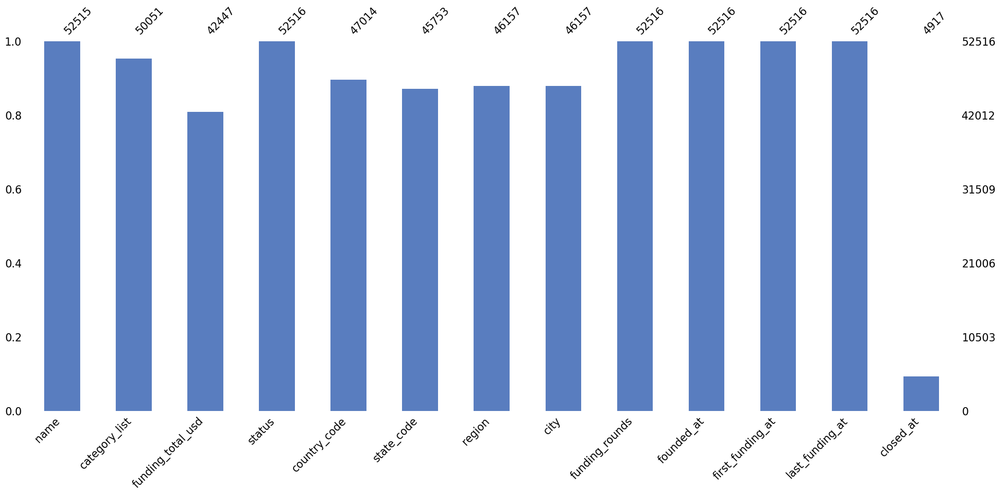

In [30]:
msno.bar(startups_train, color='#597dbf');

Удаление столбца c большим количеством пропущенных значений:

In [31]:
startups_train = startups_train.drop(columns=['closed_at'])

# проверка
startups_train.columns

Index(['name', 'category_list', 'funding_total_usd', 'status', 'country_code',
       'state_code', 'region', 'city', 'funding_rounds', 'founded_at',
       'first_funding_at', 'last_funding_at'],
      dtype='object')

Заполнение пропущенных значений:

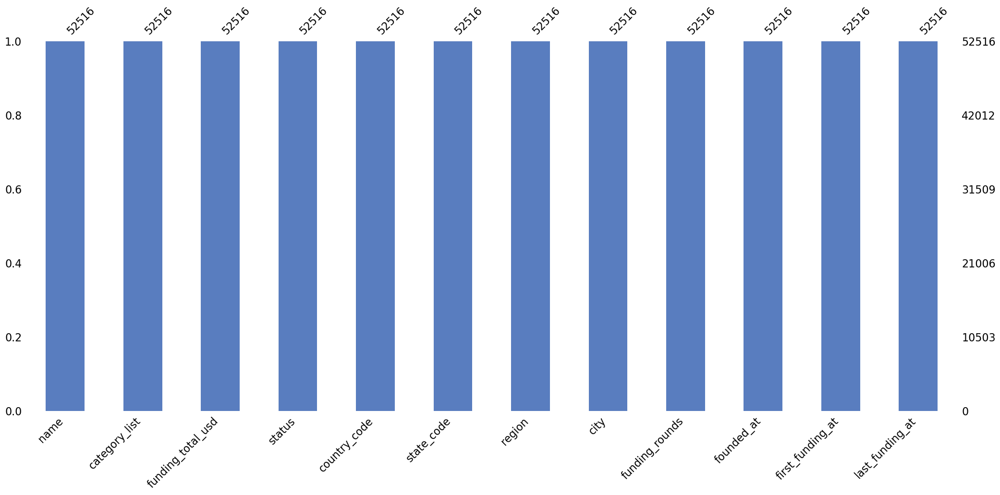

In [32]:
# числовые столбцы
num_cols = list(startups_train.select_dtypes(include=['number']).columns)

# категориальные столбцы
cat_cols = list(startups_train.select_dtypes(include=['category']).columns)

# текстовые столбцы
obj_cols = list(startups_train.select_dtypes(include=['object']).columns)

# удаление целевого признака, так как у него нет пропущенных значений,
# а также его нет в тестовой выборке
cat_cols.remove('status')

# заполнение пропусков в числовых и категориальных столбцах
startups_train[num_cols + cat_cols + obj_cols], fillna = fill_nan(
    startups_train[num_cols + cat_cols + obj_cols],
    num_cols=num_cols,
    cat_cols=cat_cols,
    obj_cols=obj_cols
)

# проверка
msno.bar(startups_train, color='#597dbf');

**Вывод**

В тренировочном датафрейме числовой столбец `funding_total_usd` содержал 10 069 пропущенных значений, которые в последующем были заполнены медианным значением. А в столбцах `name` (1 пропуск), `category_list` (2 465 пропусков), `country_code` (5 502 пропуска), `state_code` (6 763 пропуска), `region` (6 359 пропусков), `city` (6 359 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно). Также последний столбец (`closed_at`) был удален, так как в нем было слишком много пропущенных значений (иначе говоря, он не нес никакой полезной информации для дальнейшего анализа).

#### Тестовый датафрейм

Отображение пропущенных значений:

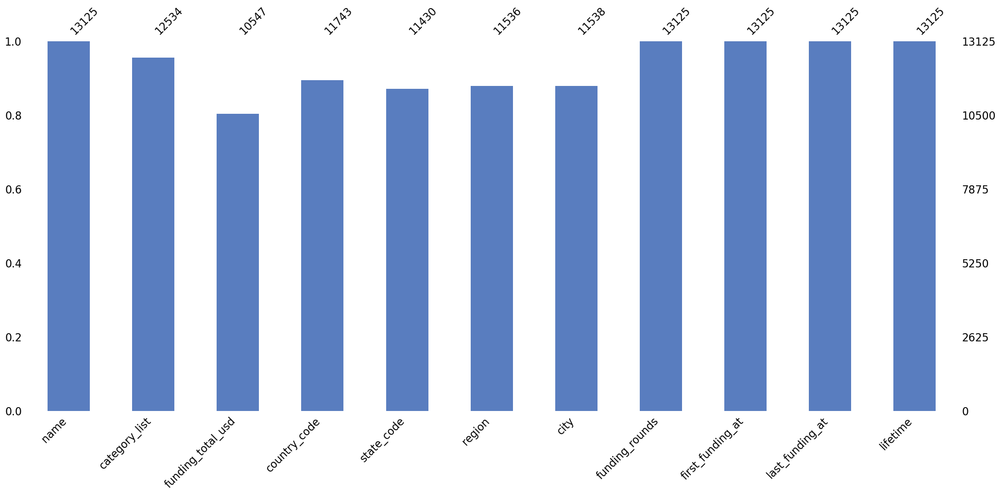

In [33]:
msno.bar(startups_test, color='#597dbf');

Заполнение пропущенных значений:

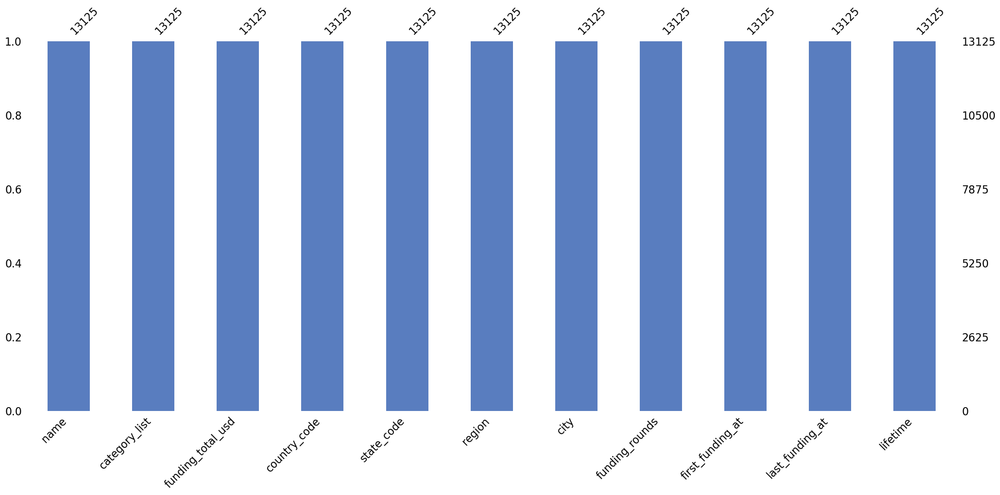

In [34]:
# заполнение пропусков
startups_test[num_cols + cat_cols + obj_cols], fillna = fill_nan(
    startups_test[num_cols + cat_cols + obj_cols],
    fillna_pipeline=fillna,
    num_cols=num_cols,
    cat_cols=cat_cols,
    obj_cols=obj_cols
)

# проверка
msno.bar(startups_test, color='#597dbf');

**Вывод**

В тестовом датафрейме числовой столбец `funding_total_usd` содержал 2 578 пропущенных значений, которые в последующем были заполнены медианным значением из тренировочной выборки. А в столбцах `category_list` (591 пропуск), `country_code` (1 382 пропуска), `state_code` (1 695 пропусков), `region` (1 589 пропусков), `city` (1 587 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно).

### Изучение дубликатов

#### Тренировочный датафрейм

Уникальные значения столбцов типа `category`:

In [35]:
cat_unique(startups_train)


Топ-50 значений для столбца: category_list
--------------------------------------------------


,category,frequency
0,Software,3207
1,Biotechnology,2905
2,unknown,2465
3,E-Commerce,1064
4,Mobile,920
5,Clean Technology,892
6,Curated Web,853
7,Health Care,744
8,Hardware + Software,733
9,Games,681



Топ-50 значений для столбца: status
--------------------------------------------------


,category,frequency
0,operating,47599
1,closed,4917



Топ-50 значений для столбца: country_code
--------------------------------------------------


,category,frequency
0,USA,29702
1,unknown,5502
2,GBR,2925
3,CAN,1540
4,IND,1276
5,CHN,1240
6,FRA,916
7,DEU,834
8,ISR,767
9,ESP,607



Топ-50 значений для столбца: state_code
--------------------------------------------------


,category,frequency
0,CA,10219
1,unknown,6763
2,NY,3112
3,MA,2020
4,TX,1562
5,H9,1510
6,7,1095
7,FL,1038
8,WA,997
9,2,913



Топ-50 значений для столбца: region
--------------------------------------------------


,category,frequency
0,SF Bay Area,6970
1,unknown,6359
2,New York City,2776
3,Boston,1890
4,London,1840
5,Los Angeles,1513
6,Seattle,955
7,"Washington, D.C.",817
8,Chicago,778
9,San Diego,703



Топ-50 значений для столбца: city
--------------------------------------------------


,category,frequency
0,unknown,6359
1,San Francisco,2824
2,New York,2486
3,London,1514
4,Austin,609
5,Palo Alto,607
6,Los Angeles,604
7,Seattle,592
8,Chicago,546
9,Cambridge,542


Укрупнение категорий:

In [36]:
# кол-во уникальных значений до преобразований
before_tr = startups_train['category_list'].nunique()

# преобразование категорий
startups_train['category_list'] = startups_train['category_list'].apply(categorize)

# кол-во уникальных значений после преобразований
after_tr = startups_train['category_list'].nunique()

# вывод результатов
print(f'кол-во уникальных значений до: {before_tr}')
print(f'кол-во уникальных значений после: {after_tr}')

кол-во уникальных значений до: 22106
кол-во уникальных значений после: 1394


Проверка кодов стран:

In [37]:
# список всех кодов стран ISO 3166-1 alpha-3
valid_country_codes = [country.alpha_3 for country in pycountry.countries]

# добавление неизвестного значения в список правильных кодов стран
valid_country_codes.append('unknown')

# проверка
check_abbr(df=startups_train, col='country_code', valid=valid_country_codes)

Встречено 40 некорректных аббревиатур

Уникальные значения:
['CHE' 'USA' 'unknown' 'GBR' 'RUS' 'ESP' 'FRA' 'SWE' 'IND' 'KOR' 'AUS'
 'TWN' 'CHN' 'HUN' 'CAN' 'FIN' 'BRA' 'EGY' 'PRT' 'ISR' 'CHL' 'SVK' 'NLD'
 'ARG' 'ARE' 'JPN' 'IRL' 'DEU' 'LBN' 'EST' 'IDN' 'BEL' 'MEX' 'DNK' 'ITA'
 'GRC' 'TUR' 'SGP' 'SAU' 'MYS' 'NGA' 'QAT' 'VNM' 'BGR' 'GHA' 'UGA' 'JOR'
 'AUT' 'PAK' 'NZL' 'HKG' 'ZAF' 'LVA' 'NOR' 'HRV' 'VEN' 'PER' 'LUX' 'SVN'
 'POL' 'PHL' 'NIC' 'CZE' 'ISL' 'PAN' 'URY' 'BGD' 'MCO' 'GTM' 'THA' 'TTO'
 'UKR' 'KEN' 'CRI' 'DZA' 'LTU' 'CYM' 'MUS' 'BLR' 'SLV' 'COL' 'MLT' 'PSE'
 'BLZ' 'CYP' 'MMR' 'MKD' 'KHM' 'GIB' 'SRB' 'DOM' 'BWA' 'BLM' 'PRY' 'BMU'
 'LIE' 'GRD' 'UZB' 'GEO' 'SEN' 'ALB' 'ECU' 'MOZ' 'LKA' 'LAO' 'TUN' 'HND'
 'ZWE' 'MDA' 'MAF' 'BHR' 'AZE' 'MAR' 'KWT' 'IRN' 'GGY' 'KNA' 'PRI' 'OMN'
 'KAZ' 'JAM' 'NPL' 'ARM' 'TGO' 'RWA' 'BRN' 'JEY' 'SOM' 'CMR' 'MNE' 'SYC'
 'ZMB']


Проверка кодов штатов:

In [38]:
# список всех кодов штатов
valid_state_codes = [state.abbr for state in us.states.STATES]

# добавление неизвестного значения в список правильных кодов штатов
valid_state_codes.append('unknown')

# проверка
check_abbr(df=startups_train, col='state_code', valid=valid_state_codes)

Встречено 16301 некорректных аббревиатур

Уникальные значения:
['unknown' 'CA' 'VA' 'NJ' 'TX' 'OR' 'FL' 'WA' 'NY' 'AZ' 'GA' 'MA' 'PA'
 'MI' 'MN' 'DE' 'RI' 'CO' 'IL' 'OH' 'AL' 'NC' 'MD' 'ND' 'VT' 'UT' 'IN'
 'CT' 'NV' 'IA' 'WI' 'NM' 'MO' 'ME' 'NH' 'SC' 'TN' 'LA' 'KS' 'AR' 'NE'
 'ID' 'MT' 'KY' 'MS' 'HI' 'AK' 'WY' 'OK' 'SD' 'WV']


Преобразование регистра в названиях регионов и городов:

In [39]:
# в столбце 'region'
startups_train['region'] = startups_train['region'].str.title()
startups_train['region'] = startups_train['region'].str.replace('Unknown', 'unknown')

# в столбце 'city'
startups_train['city'] = startups_train['city'].str.title()
startups_train['city'] = startups_train['city'].str.replace('Unknown', 'unknown')

# проверка
print(f'region: {startups_train["region"].unique()}\n')
print(f'city: {startups_train["city"].unique()}')

region: ['Zurich' 'Sf Bay Area' 'unknown' ... 'Haywards Heath' 'Herzogenaurach'
 'Doncaster']

city: ['Zürich' 'Redwood City' 'San Jose' ... 'Circleville' 'Doncaster'
 'Centreville']


Кол-во явных дубликатов:

In [40]:
# интересующие столбцы
comb_cols = list(startups_train.columns)
comb_cols.remove('name')

# вывод дубликатов
obvious_duplicates(startups_train, [comb_cols])

['category_list', 'funding_total_usd', 'status', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'founded_at', 'first_funding_at', 'last_funding_at']: 24

кол-во абсолютных явных дубликатов: 0


Удаление явных дубликатов:

In [41]:
# удаление дубликатов только по столбцу 'name'
startups_train = startups_train.drop_duplicates(subset=['name']).reset_index(drop=True)

# удаление дубликатов по всем столбцам, кроме 'name'
startups_train = startups_train.drop_duplicates(subset=comb_cols).reset_index(drop=True)

# проверка
obvious_duplicates(startups_train, [comb_cols])

['category_list', 'funding_total_usd', 'status', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'founded_at', 'first_funding_at', 'last_funding_at']: 0

кол-во абсолютных явных дубликатов: 0


**Вывод:**

В тренировочном датафрейме было произведено укрупнение категорий (`category_list`) с 22 106 до 1 394 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (40 неправильных кодов стран, 16 301 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было удалено 24 явных дубликата по всем столбцам, кроме `name`.

#### Тестовый датафрейм

Уникальные значения столбцов типа `object`:

In [42]:
cat_unique(startups_test)


Топ-50 значений для столбца: category_list
--------------------------------------------------


,category,frequency
0,Software,775
1,Biotechnology,693
2,unknown,591
3,E-Commerce,263
4,Mobile,255
5,Clean Technology,234
6,Curated Web,191
7,Hardware + Software,181
8,Games,180
9,Health Care,176



Топ-50 значений для столбца: country_code
--------------------------------------------------


,category,frequency
0,USA,7428
1,unknown,1382
2,GBR,725
3,CAN,369
4,IND,307
5,CHN,301
6,DEU,237
7,FRA,213
8,ISR,190
9,ESP,134



Топ-50 значений для столбца: state_code
--------------------------------------------------


,category,frequency
0,CA,2552
1,unknown,1695
2,NY,789
3,MA,487
4,TX,410
5,H9,382
6,7,306
7,WA,258
8,FL,249
9,2,237



Топ-50 значений для столбца: region
--------------------------------------------------


,category,frequency
0,SF Bay Area,1750
1,unknown,1589
2,New York City,712
3,London,481
4,Boston,460
5,Los Angeles,343
6,Seattle,247
7,"Washington, D.C.",203
8,Denver,190
9,San Diego,186



Топ-50 значений для столбца: city
--------------------------------------------------


,category,frequency
0,unknown,1587
1,San Francisco,656
2,New York,641
3,London,384
4,Austin,159
5,Palo Alto,155
6,Seattle,152
7,Los Angeles,144
8,Boston,140
9,San Diego,136


Укрупнение категорий:

In [43]:
# кол-во уникальных значений до преобразований
before_te = startups_test['category_list'].nunique()

# преобразование категорий
startups_test['category_list'] = startups_test['category_list'].apply(categorize)

# кол-во уникальных значений после преобразований
after_te = startups_test['category_list'].nunique()

# вывод результатов
print(f'кол-во уникальных значений до: {before_te}')
print(f'кол-во уникальных значений после: {after_te}')

кол-во уникальных значений до: 6207
кол-во уникальных значений после: 666


Проверка кодов стран:

In [44]:
check_abbr(df=startups_test, col='country_code', valid=valid_country_codes)

Встречено 6 некорректных аббревиатур

Уникальные значения:
['NIC' 'USA' 'LUX' 'CAN' 'unknown' 'MYS' 'DEU' 'GBR' 'FRA' 'ITA' 'CHN'
 'ARG' 'NLD' 'IRL' 'AUS' 'CHE' 'CHL' 'ESP' 'IND' 'ISR' 'DNK' 'KOR' 'RUS'
 'PHL' 'URY' 'SGP' 'BRA' 'EGY' 'MEX' 'POL' 'VNM' 'AUT' 'EST' 'BEL' 'DMA'
 'PRT' 'SWE' 'JOR' 'HUN' 'HKG' 'JPN' 'ZAF' 'COL' 'BGR' 'CZE' 'GRC' 'LTU'
 'TWN' 'ISL' 'IDN' 'FIN' 'NOR' 'ARE' 'UKR' 'KEN' 'NGA' 'TUR' 'CRI' 'THA'
 'CYP' 'MMR' 'VEN' 'BHR' 'NZL' 'SVK' 'CYM' 'LVA' 'MKD' 'PER' 'AZE' 'BWA'
 'BGD' 'ZWE' 'CIV' 'LKA' 'SVN' 'SRB' 'BLR' 'SAU' 'GHA' 'CMR' 'TTO' 'PAK'
 'BMU' 'PSE' 'UGA' 'MUS' 'JAM' 'LBN' 'ECU' 'PAN' 'GTM' 'HRV' 'BRB' 'ZMB']


Проверка кодов штатов:

In [45]:
check_abbr(df=startups_test, col='state_code', valid=valid_state_codes)

Встречено 4060 некорректных аббревиатур

Уникальные значения:
['unknown' 'TN' 'CA' 'VA' 'PA' 'AZ' 'AL' 'MA' 'NY' 'GA' 'FL' 'WA' 'OH'
 'CO' 'MS' 'NC' 'TX' 'MO' 'NJ' 'MD' 'MI' 'IN' 'KS' 'SC' 'UT' 'OR' 'IL'
 'LA' 'RI' 'MN' 'CT' 'KY' 'WI' 'NM' 'IA' 'NV' 'ME' 'NE' 'VT' 'NH' 'AR'
 'DE' 'WV' 'MT' 'OK' 'HI' 'ND' 'ID' 'WY' 'AK' 'SD']


Преобразование регистра в названиях регионов и городов:

In [46]:
# в столбце 'region'
startups_test['region'] = startups_test['region'].str.title()
startups_test['region'] = startups_test['region'].str.replace('Unknown', 'unknown')

# в столбце 'city'
startups_test['city'] = startups_test['city'].str.title()
startups_test['city'] = startups_test['city'].str.replace('Unknown', 'unknown')

# проверка
print(f'region: {startups_test["region"].unique()}\n')
print(f'city: {startups_test["city"].unique()}')

region: ['unknown' 'Tn - Other' 'Esch-Sur-Alzette' 'San Diego' 'Ottawa'
 'Washington, D.C.' 'Allentown' 'Phoenix' 'Kuala Lumpur' 'Cologne'
 'Huntsville' 'Boston' 'New York City' 'Sf Bay Area' 'Dusseldrof'
 'Anaheim' 'Berlin' 'London' 'Ontario - Inland Empire' 'Philadelphia'
 'Atlanta' 'Montreal' 'Nashville' 'Palm Beaches' 'Seattle' 'Cleveland'
 'Denver' 'Toronto' 'Paris' 'Meridian' 'Miami' 'Terni' 'Beijing'
 'Buenos Aires' 'Asheville' 'Los Angeles' 'Coventry' 'Nld - Other' 'Cork'
 'Sydney' 'Ca - Other' 'Dallas' 'Sarasota - Bradenton' 'Zurich' 'Hangzhou'
 'Ny - Other' 'Santiago' 'Bormujos' 'New Delhi' 'Mo - Other' 'Tel Aviv'
 'Ft. Lauderdale' 'Leeds' 'Charlotte' 'Worcester' 'Austin' 'Bangalore'
 'Pittsburgh' 'Shanghai' 'Melbourne' 'Newark' 'Md - Other' 'Thame'
 'Mi - Other' 'Seoul' 'Utrecht' 'Moscow' 'Manila' 'Montevideo' 'Singapore'
 'Fra - Other' 'In - Other' 'Kansas City' 'Bra - Other'
 'Palma De Mallorca' 'Cairo' 'Sc - Other' 'Salt Lake City'
 'Portland, Oregon' 'Santa Barbara' 'Al 

Кол-во явных дубликатов:

In [47]:
# удаление лишних столбцов из списка
comb_cols.remove('founded_at')
comb_cols.remove('status')

# отображение кол-ва явных дубликатов
obvious_duplicates(startups_test, [comb_cols])

['category_list', 'funding_total_usd', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'first_funding_at', 'last_funding_at']: 59

кол-во абсолютных явных дубликатов: 0


**Вывод:**

В тестовом датафрейме было произведено укрупнение категорий (`category_list`) с 6 207 до 666 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (6 неправильных кодов стран, 4 060 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было выявлено 59 явных дубликатов по всем столбцам, кроме `name`, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

### Изучение аномальных значений

#### Тренировочный датафрейм

Вывод расширенного статистического описания для всех числовых столбцов:

In [48]:
for col in num_cols:
    result = more_describe(df=startups_train, col=col)
    print(f'Описание для столбца: {col}')
    print(result)
    print('\n')

Описание для столбца: funding_total_usd
count             5.249200e+04
mean              1.513861e+07
std               1.683848e+08
min               1.000000e+00
25%               5.300000e+05
50%               2.000000e+06
75%               6.800000e+06
max               3.007950e+10
iqr               6.270000e+06
lower_bound       5.300000e+05
upper_bound       6.800000e+06
outliers_count    7.801000e+03
outliers_pct      1.486131e+01
outliers_min      1.621180e+07
outliers_max      3.007950e+10
Name: funding_total_usd, dtype: float64


Описание для столбца: funding_rounds
count             52492.000000
mean                  1.741008
std                   1.374745
min                   1.000000
25%                   1.000000
50%                   1.000000
75%                   2.000000
max                  19.000000
iqr                   1.000000
lower_bound           1.000000
upper_bound           2.000000
outliers_count     4761.000000
outliers_pct          9.069954
outliers_min 

Построение ящиков с усами для каждого числового столбца:

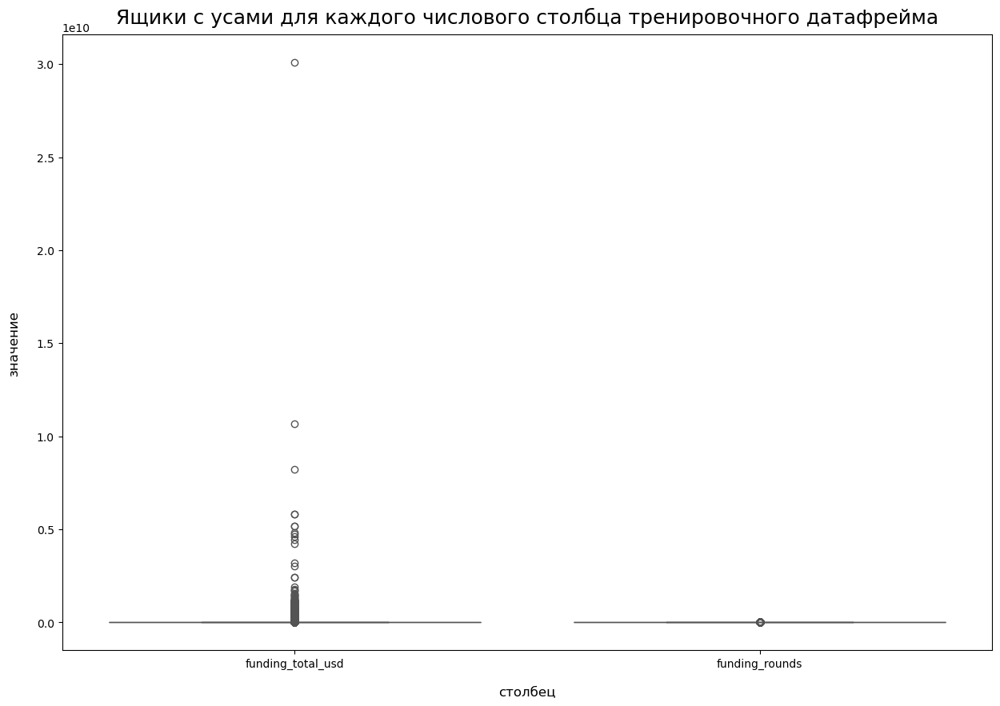

In [49]:
box_plots(startups_train, t='Ящики с усами для каждого числового столбца тренировочного датафрейма')

Удаление аномального значения в столбце `funding_total_usd`:

Описание для столбца: funding_total_usd
count             5.243700e+04
mean              1.380268e+07
std               7.356512e+07
min               1.000000e+03
25%               5.350000e+05
50%               2.000000e+06
75%               6.800000e+06
max               4.812000e+09
iqr               6.265000e+06
lower_bound       5.350000e+05
upper_bound       6.800000e+06
outliers_count    7.803000e+03
outliers_pct      1.488071e+01
outliers_min      1.620000e+07
outliers_max      4.812000e+09
Name: funding_total_usd, dtype: float64


Описание для столбца: funding_rounds
count             52437.000000
mean                  1.741309
std                   1.374203
min                   1.000000
25%                   1.000000
50%                   1.000000
75%                   2.000000
max                  19.000000
iqr                   1.000000
lower_bound           1.000000
upper_bound           2.000000
outliers_count     4758.000000
outliers_pct          9.073746
outliers_min 

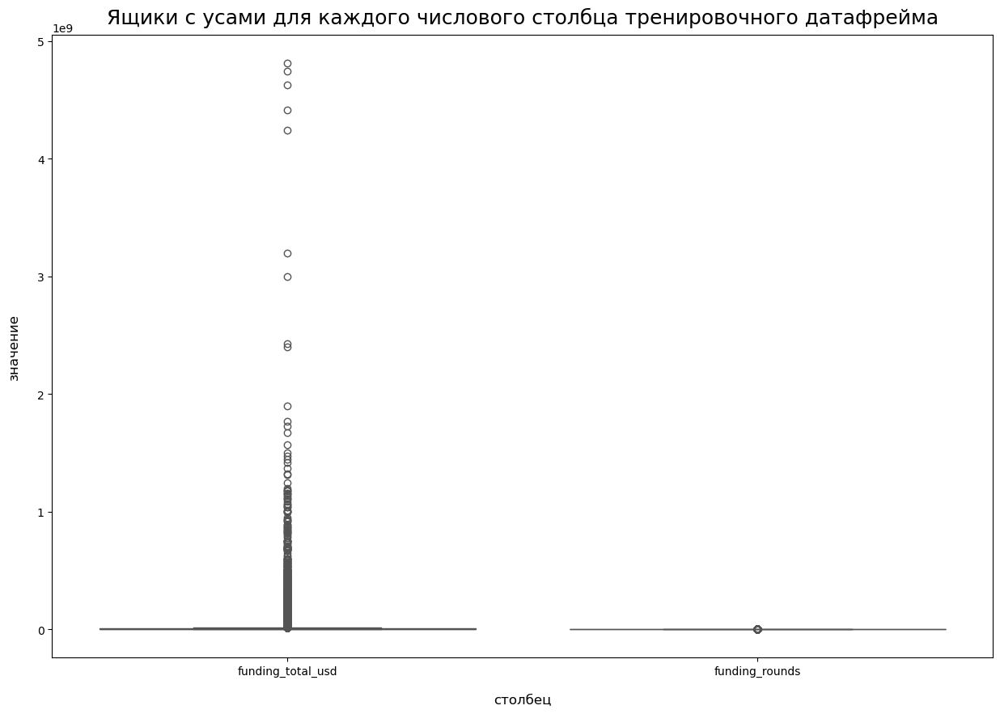

In [50]:
# удаление аномально большой общей суммы финансирования
startups_train = startups_train[startups_train['funding_total_usd'] <= 0.5e10]

# удаление аномально низкой общей суммы финансирования
startups_train = startups_train[startups_train['funding_total_usd'] >= 1_000]

# проверка
for col in num_cols:
    result = more_describe(df=startups_train, col=col)
    print(f'Описание для столбца: {col}')
    print(result)
    print('\n')
    
box_plots(startups_train, t='Ящики с усами для каждого числового столбца тренировочного датафрейма')

**Вывод:**

В столбце `funding_total_usd` тренировочного датафрейма было удалено 55 аномалий, поскольку они имели слишком большие (больше 5 млрд. долларов) и малые значения (меньше 1 000 долларов).

#### Тестовый датафрейм

Вывод расширенного статистического описания для всех числовых столбцов:

In [51]:
for col in (num_cols + ['lifetime']):
    result = more_describe(df=startups_test, col=col)
    print(f'Описание для столбца: {col}')
    print(result)
    print('\n')

Описание для столбца: funding_total_usd
count             1.312500e+04
mean              1.369138e+07
std               8.282798e+07
min               1.000000e+00
25%               5.010000e+05
50%               2.000000e+06
75%               6.513865e+06
max               4.715000e+09
iqr               6.012865e+06
lower_bound       5.010000e+05
upper_bound       6.513865e+06
outliers_count    1.946000e+03
outliers_pct      1.482667e+01
outliers_min      1.559980e+07
outliers_max      4.715000e+09
Name: funding_total_usd, dtype: float64


Описание для столбца: funding_rounds
count             13125.000000
mean                  1.714438
std                   1.318800
min                   1.000000
25%                   1.000000
50%                   1.000000
75%                   2.000000
max                  15.000000
iqr                   1.000000
lower_bound           1.000000
upper_bound           2.000000
outliers_count     1139.000000
outliers_pct          8.678095
outliers_min 

Построение ящиков с усами для каждого числового столбца:

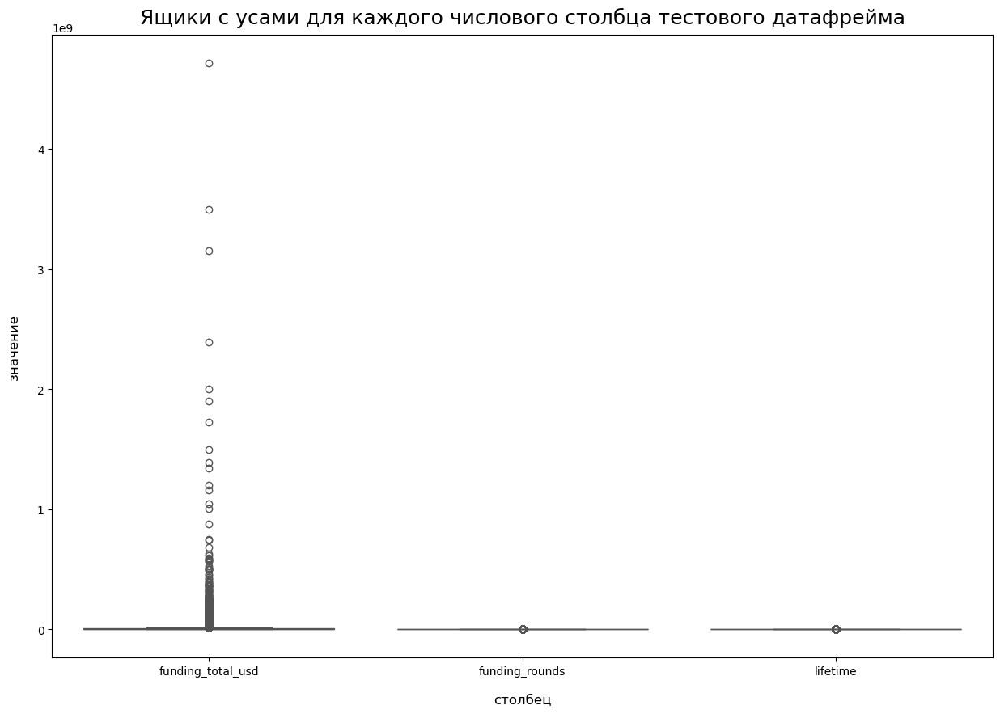

In [52]:
box_plots(startups_test, t='Ящики с усами для каждого числового столбца тестового датафрейма')

**Вывод:**

В столбце `funding_total_usd` тестового датафрейма тоже наблюдаются аномально низкие значения, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

### Удаление неинформативных признаков

Вывод всех столбцов из тренировочного и тестового датафреймов:

In [53]:
# список всех столбцов тренировочного датафрейма
print(f'Столбцы тренировочного датафрейма:\n {list(startups_train.columns)}\n')

# список всех столбцов тестового датафрейма
print(f'Столбцы тестового датафрейма:\n {list(startups_test.columns)}')

Столбцы тренировочного датафрейма:
 ['name', 'category_list', 'funding_total_usd', 'status', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'founded_at', 'first_funding_at', 'last_funding_at']

Столбцы тестового датафрейма:
 ['name', 'category_list', 'funding_total_usd', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'first_funding_at', 'last_funding_at', 'lifetime']


Удаление лишних столбцов:

In [54]:
# удаление даты основания стартапа из тренировочного датафрейма
startups_train = startups_train.drop('founded_at', axis=1)

# удаление времени существования стартапа в днях из тестового датафрейма
startups_test = startups_test.drop('lifetime', axis=1)

# проверка
print(f'Столбцы тренировочного датафрейма:\n {list(startups_train.columns)}\n')
print(f'Столбцы тестового датафрейма:\n {list(startups_test.columns)}')

Столбцы тренировочного датафрейма:
 ['name', 'category_list', 'funding_total_usd', 'status', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'first_funding_at', 'last_funding_at']

Столбцы тестового датафрейма:
 ['name', 'category_list', 'funding_total_usd', 'country_code', 'state_code', 'region', 'city', 'funding_rounds', 'first_funding_at', 'last_funding_at']


**Вывод:**

В тренировочном датафрейме была удалена дата основания стартапа (`founded_at`), так как такого признака нет в тестовой выборке. Также в тестовом датафрейме было удалено время существования стартапа в днях (`lifetime`), поскольку такого признака нет в тренировочной выборке, а воссоздать его не представляется возможным.

### Вывод предобработки данных

#### Проверка типов данных

В тренировочном датафрейме столбцы `founded_at`, `first_funding_at`, `last_funding_at`, `closed_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `status`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

В тестовом датафрейме столбцы `first_funding_at`, `last_funding_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

#### Изучение пропущенных значений

В тренировочном датафрейме числовой столбец `funding_total_usd` содержал 10 069 пропущенных значений, которые в последующем были заполнены медианным значением. А в столбцах `name` (1 пропуск), `category_list` (2 465 пропусков), `country_code` (5 502 пропуска), `state_code` (6 763 пропуска), `region` (6 359 пропусков), `city` (6 359 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно). Также последний столбец (`closed_at`) был удален, так как в нем было слишком много пропущенных значений (иначе говоря, он не нес никакой полезной информации для дальнейшего анализа).

В тестовом датафрейме числовой столбец `funding_total_usd` содержал 2 578 пропущенных значений, которые в последующем были заполнены медианным значением из тренировочной выборки. А в столбцах `category_list` (591 пропуск), `country_code` (1 382 пропуска), `state_code` (1 695 пропусков), `region` (1 589 пропусков), `city` (1 587 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно).

#### Изучение дубликатов

В тренировочном датафрейме было произведено укрупнение категорий (`category_list`) с 22 106 до 1 394 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (40 неправильных кодов стран, 16 301 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было удалено 24 явных дубликатов по всем столбцам, кроме `name`.

В тестовом датафрейме было произведено укрупнение категорий (`category_list`) с 6 207 до 666 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (6 неправильных кодов стран, 4 060 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было выявлено 59 явных дубликатов по всем столбцам, кроме `name`, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

#### Изучение аномальных значений

В столбце `funding_total_usd` тренировочного датафрейма было удалено 55 аномалий, поскольку они имели слишком большие (больше 5 млрд. долларов) и малые значения (меньше 1 000 долларов).

В столбце `funding_total_usd` тестового датафрейма тоже наблюдаются аномально низкие значения, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

#### Удаление неинформативных признаков

В тренировочном датафрейме была удалена дата основания стартапа (`founded_at`), так как такого признака нет в тестовой выборке. Также в тестовом датафрейме было удалено время существования стартапа в днях (`lifetime`), поскольку такого признака нет в тренировочной выборке, а воссоздать его не представляется возможным.

## Исследовательский анализ данных

### Распределение категорий стартапов

#### Тренировочная выборка

In [55]:
tree_map(
    df=startups_train,
    cat='category_list',
    subcat='status',
    t='Распределение категорий стартапов в тренировочной выборке'
)

**Вывод:**

В тренировочной выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.67% (8 561 действующих, 701 закрытых). На втором месте находится категория `Medicine` с долей в 11.65% (5 770 действующих, 343 закрытых), на третьем — `Media` c долей в 8.47% (3 810 действующих, 629 закрытых), на четвертом — `Other` с долей в 5.46% (2 675 действующих, 188 закрытых), на пятом — `unknown` с долей в 4.67% (1 727 действующих, 726 закрытых).

#### Тестовая выборка

In [56]:
tree_map(
    df=startups_test,
    cat='category_list',
    t='Распределение категорий стартапов в тестовой выборке'
)

**Вывод:**

В тестовой выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.45% (2 290 стартапов). На втором месте находится категория `Medicine` с долей в 11.49% (1 508 стартапов), на третьем — `Media` c долей в 8.25% (1 083 стартапа), на четвертом — `Other` с долей в 5.61% (736 стартапов), на пятом — `unknown` с долей в 4.5% (591 стартап).

### Распределение общих сумм финансирования стартапов

#### Тренировочная выборка

Вывод расширенного статистического описания:

In [57]:
more_describe(df=startups_train, col='funding_total_usd', hue='status')

,operating,closed
count,4.752800e+04,4.909000e+03
mean,1.426159e+07,9.359598e+06
std,7.607715e+07,4.184525e+07
min,1.000000e+03,1.000000e+03
25%,5.677901e+05,3.741580e+05
50%,2.000000e+06,2.000000e+06
75%,7.000000e+06,5.000000e+06
max,4.812000e+09,1.567504e+09
iqr,6.432210e+06,4.625842e+06
lower_bound,5.677901e+05,3.741580e+05


Составление графика:

In [58]:
hist_plot(
    df=startups_train,
    x='funding_total_usd',
    hue='status',
    xlim=(0, 16.64835e6),
    xl='общая сумма финансирования (в долларах)',
    yl='кол-во стартапов',
    lt='Статусы',
    t='Распределение общих сумм финансирования стартапов в тренировочной выборке'
)

**Вывод:**

Распределение общих сумм финансирования стартапов в тренировочной выборке имеет сильную правостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений 1-3 млн. долларов (16 034 стартапов), а у закрывшихся — 0.001-1 млн. долларов (1 716 стартапов). Также у обоих распределений минимальные значения совпадают (в значении 1 тыс. долларов), а максимальные расходятся (у действующих стартапов — примерно 4.812 млрд. долларов, а у закрывшихся — 1.567 млрд. долларов). В предоставленных данных, обе группы стартапов имеют одинаковые общие суммы финансирования, так как их меиданы совпадают в значении 2 млн. долларов. При этом межквартильный размах у действующих стартапов шире (примерно на 1.81 млн. долларов), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 15.06% выбросов (в значениях больше 16.648 млн. долларов), а у закрывшихся — 14.73% (в значениях больше 11.885 млн. долларов).

#### Тестовая выборка

Вывод расширенного статистического описания:

In [59]:
more_describe(df=startups_test, col='funding_total_usd')

count             1.312500e+04
mean              1.369138e+07
std               8.282798e+07
min               1.000000e+00
25%               5.010000e+05
50%               2.000000e+06
75%               6.513865e+06
max               4.715000e+09
iqr               6.012865e+06
lower_bound       5.010000e+05
upper_bound       6.513865e+06
outliers_count    1.946000e+03
outliers_pct      1.482667e+01
outliers_min      1.559980e+07
outliers_max      4.715000e+09
Name: funding_total_usd, dtype: float64

Составление графика:

In [60]:
hist_plot(
    df=startups_test,
    x='funding_total_usd',
    xlim=(0, 15.5e6),
    xl='общая сумма финансирования (в долларах)',
    yl='кол-во стартапов',
    t='Распределение общих сумм финансирования стартапов в тестовой выборке'
)

**Вывод:**

Распределение общих сумм финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений от 1 доллара до 2.5 млн. долларов (8 245 стартапов). Также минимальное значение составляет 1 доллар, а максимальное — 4.715 млрд. долларов. Межквартильный размах составляет примерно 6.013 млн. долларов. Обнаружено 14.83% выбросов (в значениях больше 15.5 млн. долларов).

### Распределение географических местоположений стартапов

#### Тренировочная выборка

In [61]:
# графическое отображение всех стран с их регионами и городами
tree_map(
    df=startups_train,
    cat='country_code',
    subcat='region',
    subsubcat='city',
    t='Распределение географических местоположений стартапов в тренировочной выборке'
)

# графическое отображение всех стран и городов с разбивкой по статусу стартапов
tree_map(
    df=startups_train,
    cat='country_code',
    subcat='city',
    subsubcat='status',
    t='Распределение географических местоположений стартапов с разбивкой по их статусу в тренировочной выборке'
)

# графическое отображение всех штатов с разбивкой по статусу стартапов
tree_map(
    df=startups_train,
    cat='state_code',
    subcat='status',
    t='Распределение штатов с разбивкой по статусу стартапов в тренировочной выборке'
)

**Вывод:**

В тренировочной выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 4.89% действующих и 0.49% закрывшихся стартапов, `Palo Alto` — 1.03% действующих и 0.12% закрывшихся стартапов, `Mountain View` — 0.84% действующих и 0.05% закрывшихся стартапов), при этом наиболее популярные штаты: `unknown` (38.87% действующих и 5.04% закрывшихся стартапов), `CA` (17.69% действующих и 1.78% закрывшихся стартапов), `NY` (5.47% действующих и 0.46% закрывшихся стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (8.01% действующих и 2.44% закрывшихся стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.67% действующих и 0.2% закрывшихся стартапов, `Cambridge` — 0.18% действующих и 0.01% закрывшихся стартапов, `Oxford` — 0.06% действующих и 0.002% закрывшихся стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.73% действующих и 0.08% закрывшихся стартапов, `Waterloo` — 0.06% действующих и 0.01% закрывшихся стартапов, `Kitchener` — 0.05% действующих и 0.002% закрывшихся стартапов). На пятом — `FRA` с наиболее популярным регионом `Paris` (города: `Paris` — 0.84% действующих и 0.08% закрывшихся стартапов, `Boulogne-Billancourt` — 0.03% действующих и 0.002% закрывшихся стартапов, `Courbevoie` — 0.01% действующих и 0% закрывшихся стартапов).

#### Тестовая выборка

In [62]:
# графическое отображение всех стран с их регионами и городами
tree_map(
    df=startups_test,
    cat='country_code',
    subcat='region',
    subsubcat='city',
    t='Распределение географических местоположений стартапов в тестовой выборке'
)

# графическое отображение всех штатов с разбивкой по статусу стартапов
tree_map(
    df=startups_test,
    cat='state_code',
    t='Распределение штатов стартапов в тестовой выборке'
)

**Вывод:**

В тестовой выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 5% стартапов, `Palo Alto` — 1.18% стартапов, `Mountain View` — 0.99% стартапов), при этом наиболее популярные штаты: `unknown` (43.85% стартапов), `CA` (19.44% стартапов), `NY` (6.01% стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (10.54% стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.91% стартапов, `Cambridge` — 0.22% стартапов, `Oxford` — 0.06% стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.72% стартапов, `Waterloo` — 0.11% стартапов, `Kitchener` — 0.08% стартапов). На пятом — `DEU` с наиболее популярным регионом `Berlin` (города: `Berlin` — 0.36% стартапов, `Potsdam` — 0.03% стартапов, `Berlin-Baumschulenweg` — 0.01% стартапов).

### Распределение кол-ва раундов финансирования стартапов

#### Тренировочная выборка

Вывод расширенного статистического описания:

In [63]:
more_describe(df=startups_train, col='funding_rounds', hue='status')

,operating,closed
count,47528.000000,4909.000000
mean,1.776048,1.404970
std,1.405305,0.962724
min,1.000000,1.000000
25%,1.000000,1.000000
50%,1.000000,1.000000
75%,2.000000,1.000000
max,19.000000,11.000000
iqr,1.000000,0.000000
lower_bound,1.000000,1.000000


Составление графика:

In [64]:
hist_plot(
    df=startups_train,
    x='funding_rounds',
    hue='status',
    xl='кол-во раундов',
    yl='кол-во стартапов',
    lt='Статусы',
    t='Распределение кол-ва раундов финансирования стартапов в тренировочной выборке'
)

**Вывод:**

Распределение кол-ва раундов финансирования стартапов в тренировочной выборке имеет сильную правостороннюю асимметрию, при этом пик у действующих (29 666 стартапов) и закрывшихся (3 751 стартап) стартапов находится в значении 1-го раунда. Также у обоих распределений минимальные значения совпадают (в значении 1-го раунда), а максимальные расходятся (у действующих стартапов — 19 раундов, а у закрывшихся — 11 раундов). В предоставленных данных, обе группы стартапов имеют одинаковые кол-ва раундов финансирования, так как их меиданы совпадают в значении 1-го раунда. При этом межквартильный размах у действующих стартапов шире (на один раунд), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 9.59% выбросов (в значениях больше 3-х раундов), а у закрывшихся — 23.59% (в значениях больше 1-го раунда).

#### Тестовая выборка

Вывод расширенного статистического описания:

In [65]:
more_describe(df=startups_test, col='funding_rounds')

count             13125.000000
mean                  1.714438
std                   1.318800
min                   1.000000
25%                   1.000000
50%                   1.000000
75%                   2.000000
max                  15.000000
iqr                   1.000000
lower_bound           1.000000
upper_bound           2.000000
outliers_count     1139.000000
outliers_pct          8.678095
outliers_min          4.000000
outliers_max         15.000000
Name: funding_rounds, dtype: float64

Составление графика:

In [66]:
hist_plot(
    df=startups_test,
    x='funding_rounds',
    xl='кол-во раундов',
    yl='кол-во стартапов',
    t='Распределение кол-ва раундов финансирования стартапов в тестовой выборке'
)

**Вывод:**

Распределение кол-ва раундов финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в значении 1-го раунда (8 449 стартапов). Также минимальное значение составляет 1 раунд, а максимальное — 15 раундов. Межквартильный размах составляет 1 раунд. Обнаружено 8.68% выбросов (в значениях больше 3 раундов).

### Распределение дат первого раунда финансирования стартапов

#### Тренировочная выборка

Вывод расширенного статистического описания:

In [67]:
more_describe(df=startups_train, col='first_funding_at', hue='status')

,operating,closed
count,47528,4909
mean,2011-09-09 23:59:30.913987584,2010-01-23 18:59:19.665919744
min,1977-05-15 00:00:00,1982-03-20 00:00:00
25%,2010-01-01 00:00:00,2007-08-02 00:00:00
50%,2012-09-13 12:00:00,2010-08-10 00:00:00
75%,2014-04-14 00:00:00,2013-06-01 00:00:00
max,2015-12-05 00:00:00,2015-12-04 00:00:00
iqr,1564 days 00:00:00,2130 days 00:00:00
lower_bound,2010-01-01 00:00:00,2007-08-02 00:00:00
upper_bound,2014-04-14 00:00:00,2013-06-01 00:00:00


Составление графика:

In [68]:
hist_plot(
    df=startups_train,
    x='first_funding_at',
    hue='status',
    xl='дата первого раунда финансирования',
    yl='кол-во стартапов',
    lt='Статусы',
    t='Распределение дат первого раунда финансирования стартапов в тренировочной выборке'
)

**Вывод:**

Распределение дат первого раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с января по февраль 2014 года (1 746 стартапов), а у закрывшихся — с мая по инюнь 2015 года (172 стартапа). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-05`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты первого раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2012-09-13 12:00:00`, у закрывшихся стартапов — `2010-08-10`). При этом межквартильный размах у закрывшихся стартапов шире (на 566 дней), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 3.58% выбросов (в значениях до августа 2003), а у закрывшихся — 0.94% (в значениях до января 1999).

#### Тестовая выборка

Вывод расширенного статистического описания:

In [69]:
more_describe(df=startups_test, col='first_funding_at')

count                                  13125
mean              2011-07-23 20:54:08.640000
min                      1973-04-15 00:00:00
25%                      2009-11-16 00:00:00
50%                      2012-08-01 00:00:00
75%                      2014-04-01 00:00:00
max                      2015-12-03 00:00:00
iqr                       1597 days 00:00:00
lower_bound              2009-11-16 00:00:00
upper_bound              2014-04-01 00:00:00
outliers_count                           492
outliers_pct                        3.748571
outliers_min             1973-04-15 00:00:00
outliers_max             2003-04-17 00:00:00
Name: first_funding_at, dtype: object

Составление графика:

In [70]:
hist_plot(
    df=startups_test,
    x='first_funding_at',
    xl='дата первого раунда финансирования',
    yl='кол-во стартапов',
    t='Распределение дат первого раунда финансирования стартапов в тестовой выборке'
)

**Вывод:**

Распределение дат первого раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с января по февраль 2014 года (469 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-03`. Межквартильный размах составляет 1 597 дней. Обнаружено 3.75% выбросов (в значениях до апреля 2003).

### Распределение дат последнего раунда финансирования стартапов

#### Тренировочная выборка

Вывод расширенного статистического описания:

In [71]:
more_describe(df=startups_train, col='last_funding_at', hue='status')

,operating,closed
count,47528,4909
mean,2012-09-07 19:26:44.578353664,2010-07-24 15:50:07.455693568
min,1977-05-15 00:00:00,1982-03-20 00:00:00
25%,2011-06-13 00:00:00,2008-04-01 00:00:00
50%,2013-10-15 00:00:00,2011-04-01 00:00:00
75%,2014-12-01 00:00:00,2013-11-01 00:00:00
max,2015-12-07 00:00:00,2015-12-04 00:00:00
iqr,1267 days 00:00:00,2040 days 00:00:00
lower_bound,2011-06-13 00:00:00,2008-04-01 00:00:00
upper_bound,2014-12-01 00:00:00,2013-11-01 00:00:00


Составление графика:

In [72]:
hist_plot(
    df=startups_train,
    x='last_funding_at',
    hue='status',
    xl='дата последнего раунда финансирования',
    yl='кол-во стартапов',
    lt='Статусы',
    t='Распределение дат последнего раунда финансирования стартапов в тренировочной выборке'
)

**Вывод:**

Распределение дат последнего раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с марта по апрель 2015 года (2 203 стартапа), а у закрывшихся — с мая по инюнь 2015 года (188 стартапов). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-07`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты последнего раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2013-10-15`, у закрывшихся стартапов — `2011-04-01`). При этом межквартильный размах у закрывшихся стартапов шире (на 773 дня), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 5.03% выбросов (в значениях до марта 2006), а у закрывшихся — 0.94% (в значениях до ноября 1999).

#### Тестовая выборка

Вывод расширенного статистического описания:

In [73]:
more_describe(df=startups_test, col='last_funding_at')

count                                     13125
mean              2012-06-16 05:03:41.348571392
min                         1973-04-15 00:00:00
25%                         2011-01-10 00:00:00
50%                         2013-08-21 00:00:00
75%                         2014-11-11 00:00:00
max                         2015-12-12 00:00:00
iqr                          1401 days 00:00:00
lower_bound                 2011-01-10 00:00:00
upper_bound                 2014-11-11 00:00:00
outliers_count                              572
outliers_pct                           4.358095
outliers_min                1973-04-15 00:00:00
outliers_max                2005-04-07 00:00:00
Name: last_funding_at, dtype: object

Составление графика:

In [74]:
hist_plot(
    df=startups_test,
    x='last_funding_at',
    xl='дата последнего раунда финансирования',
    yl='кол-во стартапов',
    t='Распределение дат последнего раунда финансирования стартапов в тестовой выборке'
)

**Вывод:**

Распределение дат последнего раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с марта по апрель 2015 года (575 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-12`. Межквартильный размах составляет 1 401 день. Обнаружено 4.36% выбросов (в значениях до апреля 2005).

### Распределение статусов стартапов в тренировочной выборке

In [75]:
pie_plot(df=startups_train,
         col='status',
         lt='Статусы',
         t='Распределение статусов стартапов в тренировочной выборке'
)

**Вывод:**

В тренировочной выборке наблюдается огромный дисбаланс категорий целевого признака `status` в сторону действующих стартапов, имеющих долю примерно в 90.6% (47 528 стартапов). При этом доля у закрывшихся стартапов составляет 9.4% (4 909 стартапов).

### Вывод исследовательского анализа данных

#### Распределение категорий стартапов

В тренировочной выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.67% (8 561 действующих, 701 закрытых). На втором месте находится категория `Medicine` с долей в 11.65% (5 770 действующих, 343 закрытых), на третьем — `Media` c долей в 8.47% (3 810 действующих, 629 закрытых), на четвертом — `Other` с долей в 5.46% (2 675 действующих, 188 закрытых), на пятом — `unknown` с долей в 4.67% (1 727 действующих, 726 закрытых).

В тестовой выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.45% (2 290 стартапов). На втором месте находится категория `Medicine` с долей в 11.49% (1 508 стартапов), на третьем — `Media` c долей в 8.25% (1 083 стартапа), на четвертом — `Other` с долей в 5.61% (736 стартапов), на пятом — `unknown` с долей в 4.5% (591 стартап).

#### Распределение общих сумм финансирования стартапов

Распределение общих сумм финансирования стартапов в тренировочной выборке имеет сильную правостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений 1-3 млн. долларов (16 034 стартапов), а у закрывшихся — 0.001-1 млн. долларов (1 716 стартапов). Также у обоих распределений минимальные значения совпадают (в значении 1 тыс. долларов), а максимальные расходятся (у действующих стартапов — примерно 4.812 млрд. долларов, а у закрывшихся — 1.567 млрд. долларов). В предоставленных данных, обе группы стартапов имеют одинаковые общие суммы финансирования, так как их меиданы совпадают в значении 2 млн. долларов. При этом межквартильный размах у действующих стартапов шире (примерно на 1.81 млн. долларов), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 15.06% выбросов (в значениях больше 16.648 млн. долларов), а у закрывшихся — 14.73% (в значениях больше 11.885 млн. долларов).

Распределение общих сумм финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений от 1 доллара до 2.5 млн. долларов (8 245 стартапов). Также минимальное значение составляет 1 доллар, а максимальное — 4.715 млрд. долларов. Межквартильный размах составляет примерно 6.013 млн. долларов. Обнаружено 14.83% выбросов (в значениях больше 15.5 млн. долларов).

#### Распределение географических местоположений стартапов

В тренировочной выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 4.89% действующих и 0.49% закрывшихся стартапов, `Palo Alto` — 1.03% действующих и 0.12% закрывшихся стартапов, `Mountain View` — 0.84% действующих и 0.05% закрывшихся стартапов), при этом наиболее популярные штаты: `unknown` (38.87% действующих и 5.04% закрывшихся стартапов), `CA` (17.69% действующих и 1.78% закрывшихся стартапов), `NY` (5.47% действующих и 0.46% закрывшихся стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (8.01% действующих и 2.44% закрывшихся стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.67% действующих и 0.2% закрывшихся стартапов, `Cambridge` — 0.18% действующих и 0.01% закрывшихся стартапов, `Oxford` — 0.06% действующих и 0.002% закрывшихся стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.73% действующих и 0.08% закрывшихся стартапов, `Waterloo` — 0.06% действующих и 0.01% закрывшихся стартапов, `Kitchener` — 0.05% действующих и 0.002% закрывшихся стартапов). На пятом — `FRA` с наиболее популярным регионом `Paris` (города: `Paris` — 0.84% действующих и 0.08% закрывшихся стартапов, `Boulogne-Billancourt` — 0.03% действующих и 0.002% закрывшихся стартапов, `Courbevoie` — 0.01% действующих и 0% закрывшихся стартапов).

В тестовой выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 5% стартапов, `Palo Alto` — 1.18% стартапов, `Mountain View` — 0.99% стартапов), при этом наиболее популярные штаты: `unknown` (43.85% стартапов), `CA` (19.44% стартапов), `NY` (6.01% стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (10.54% стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.91% стартапов, `Cambridge` — 0.22% стартапов, `Oxford` — 0.06% стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.72% стартапов, `Waterloo` — 0.11% стартапов, `Kitchener` — 0.08% стартапов). На пятом — `DEU` с наиболее популярным регионом `Berlin` (города: `Berlin` — 0.36% стартапов, `Potsdam` — 0.03% стартапов, `Berlin-Baumschulenweg` — 0.01% стартапов).

#### Распределение дат первого раунда финансирования стартапов

Распределение дат первого раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с января по февраль 2014 года (1 746 стартапов), а у закрывшихся — с мая по инюнь 2015 года (172 стартапа). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-05`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты первого раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2012-09-13 12:00:00`, у закрывшихся стартапов — `2010-08-10`). При этом межквартильный размах у закрывшихся стартапов шире (на 566 дней), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 3.58% выбросов (в значениях до августа 2003), а у закрывшихся — 0.94% (в значениях до января 1999).

Распределение дат первого раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с января по февраль 2014 года (469 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-03`. Межквартильный размах составляет 1 597 дней. Обнаружено 3.75% выбросов (в значениях до апреля 2003).

#### Распределение дат последнего раунда финансирования стартапов

Распределение дат последнего раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с марта по апрель 2015 года (2 203 стартапа), а у закрывшихся — с мая по инюнь 2015 года (188 стартапов). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-07`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты последнего раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2013-10-15`, у закрывшихся стартапов — `2011-04-01`). При этом межквартильный размах у закрывшихся стартапов шире (на 773 дня), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 5.03% выбросов (в значениях до марта 2006), а у закрывшихся — 0.94% (в значениях до ноября 1999).

Распределение дат последнего раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с марта по апрель 2015 года (575 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-12`. Межквартильный размах составляет 1 401 день. Обнаружено 4.36% выбросов (в значениях до апреля 2005).

#### Распределение статусов стартапов в тренировочной выборке

В тренировочной выборке наблюдается огромный дисбаланс категорий целевого признака `status` в сторону действующих стартапов, имеющих долю примерно в 90.6% (47 528 стартапов). При этом доля у закрывшихся стартапов составляет 9.4% (4 909 стартапов).

## Разработка новых синтетических признаков

### Преобразование дат в числовой формат

#### Тренировочная выборка

In [76]:
startups_train['first_funding_at'] = pd.to_datetime(startups_train['first_funding_at']).astype('int64') // 10**9
startups_train['last_funding_at'] = pd.to_datetime(startups_train['last_funding_at']).astype('int64') // 10**9

# проверка
startups_train.dtypes

name                   object
category_list          object
funding_total_usd     float64
status               category
country_code           object
state_code             object
region                 object
city                   object
funding_rounds          int64
first_funding_at        int64
last_funding_at         int64
dtype: object

**Вывод:**

В тренировочной выборке все даты были переведены в числовой формат (секунды от эпохи Unix).

#### Тестовая выборка

In [77]:
startups_test['first_funding_at'] = pd.to_datetime(startups_test['first_funding_at']).astype('int64') // 10**9
startups_test['last_funding_at'] = pd.to_datetime(startups_test['last_funding_at']).astype('int64') // 10**9

# проверка
startups_test.dtypes

name                  object
category_list         object
funding_total_usd    float32
country_code          object
state_code            object
region                object
city                  object
funding_rounds         int64
first_funding_at       int64
last_funding_at        int64
dtype: object

**Вывод:**

В тестовой выборке все даты были переведены в числовой формат (секунды от эпохи Unix).

### Получение координат городов стартапов

#### Тренировочная выборка

Получение координат всех городов:

In [78]:
# get_coords_city(
    # df=startups_train,
    # col='city',
    # path_to_save='datasets/startups_train_with_coords.csv'
# )

Считывание полученных координат:

In [79]:
# перезапись датафрейма
startups_train = create_dataframe('datasets/startups_train_with_coords.csv')

# проверка
startups_train.head(10)

,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,latitude,longitude
0,Lunchgate,Food,828626.0,operating,CHE,unknown,Zurich,Zürich,2,1304208000,1417392000,47.374449,8.541042
1,EarLens,Industry|Medicine,42935020.0,operating,USA,CA,Sf Bay Area,Redwood City,4,1272931200,1393286400,37.486324,-122.232523
2,Reviva Pharmaceuticals,Medicine,35456380.0,operating,USA,CA,Sf Bay Area,San Jose,3,1345420800,1404259200,37.336166,-121.890591
3,Sancilio and Company,Medicine,22250000.0,operating,unknown,unknown,unknown,unknown,3,1314835200,1405641600,26.492533,92.330879
4,WireTough Cylinders,Industry,2000000.0,operating,USA,VA,Va - Other,Bristol,1,1328054400,1328054400,51.453802,-2.597298
5,Connected Sports Ventures,IT,4300000.0,operating,USA,NJ,Newark,Princeton,1,1352678400,1352678400,40.349695,-74.659738
6,Attensity,IT,90000000.0,operating,USA,CA,Sf Bay Area,Redwood City,1,1400025600,1400025600,37.486324,-122.232523
7,Mesh Networks,IT,4300000.0,operating,USA,TX,Houston,Houston,1,1415491200,1415491200,29.758938,-95.367697
8,AngioScore,Medicine,42000000.0,operating,USA,CA,Sf Bay Area,Fremont,2,1191888000,1303257600,37.548270,-121.988571
9,Vidatronic,Industry,1250500.0,operating,USA,TX,Austin,College Station,2,1314057600,1363824000,30.618394,-96.345599


Отображение типов данных:

In [80]:
startups_train.dtypes

name                  object
category_list         object
funding_total_usd    float64
status                object
country_code          object
state_code            object
region                object
city                  object
funding_rounds         int64
first_funding_at       int64
last_funding_at        int64
latitude             float64
longitude            float64
dtype: object

Изменение типов данных:

In [81]:
# словарь для изменения типов данных
data_types_train = {
    'category_list': 'category',
    'status': 'category',
    'country_code': 'category',
    'state_code': 'category',
    'region': 'category',
    'city': 'category',
    'latitude': 'float32',
    'longitude': 'float32'
}

# изменение типов данных
startups_train = change_data_types(
    df=startups_train,
    column_types=data_types_train
)

name                   object
category_list        category
funding_total_usd     float64
status               category
country_code         category
state_code           category
region               category
city                 category
funding_rounds          int64
first_funding_at        int64
last_funding_at         int64
latitude              float32
longitude             float32
dtype: object


Отображение пропущенных значений:

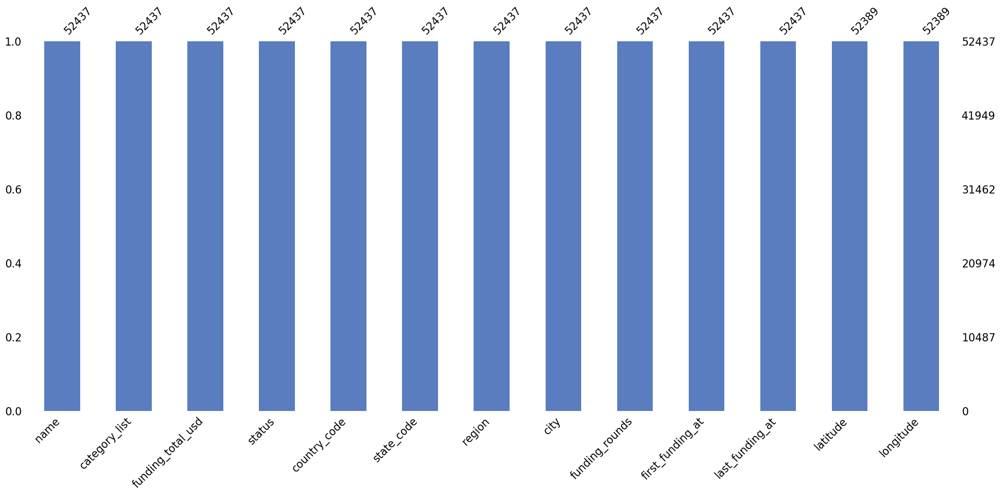

In [82]:
msno.bar(startups_train, color='#597dbf');

Заполнение пропущенных координат:

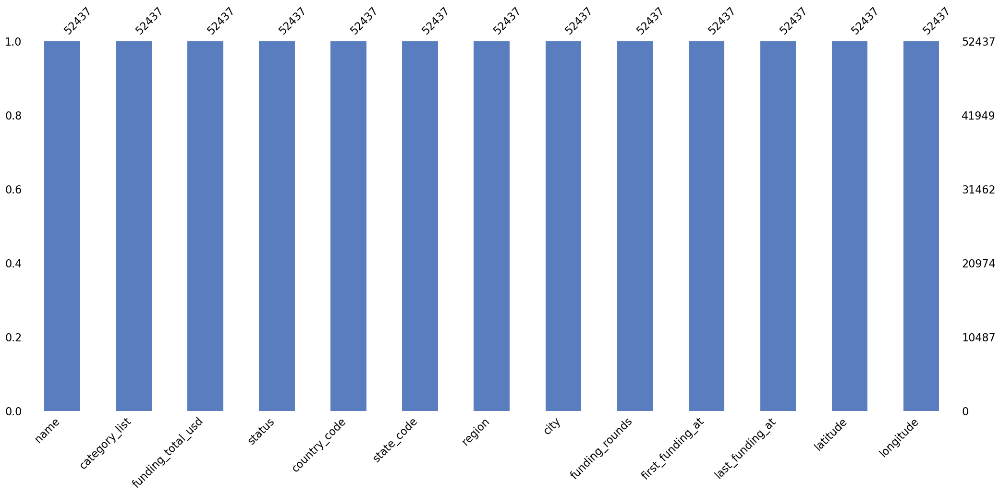

In [83]:
startups_train[['latitude', 'longitude']] = startups_train[['latitude', 'longitude']].fillna({'latitude': 0.0, 'longitude': 0.0})

# проверка
msno.bar(startups_train, color='#597dbf');

**Вывод:**

В тренировочной выборке созданы новые признаки, отображающие координаты городов (`latitude` — широта, `longitude` — долгота), в которых находятся стартапы. Причем их типы данных были переведны из `float64` в `float32` для экономии вычислительной памяти, а также заполнены пропущенные значения координатами `0.0`.

#### Тестовая выборка

Получение координат всех городов:

In [84]:
# get_coords_city(
    # df=startups_test,
    # col='city',
    # path_to_save='datasets/startups_test_with_coords.csv'
# )

Считывание полученных координат:

In [85]:
# перезапись датафрейма
startups_test = create_dataframe('datasets/startups_test_with_coords.csv')

# проверка
startups_test.head(10)

,name,category_list,funding_total_usd,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,latitude,longitude
0,Crystalsol,Energy,2819200.0,NIC,unknown,unknown,unknown,1,1246406400,1246406400,26.492533,92.330879
1,JBI Fish & Wings,Real Estate,2000000.0,USA,TN,Tn - Other,Humboldt,1,1280275200,1280275200,40.599742,-123.899773
2,COINPLUS,Finance,428257.0,LUX,unknown,Esch-Sur-Alzette,Esch-Sur-Alzette,2,1400112000,1410998400,49.495963,5.985031
3,Imagine Communications,IT|Media,34700000.0,USA,CA,San Diego,San Diego,4,1104537600,1271721600,32.717420,-117.162772
4,DNA13,IT,4530000.0,CAN,unknown,Ottawa,Ottawa,1,1178582400,1178582400,45.420878,-75.690111
5,Quickfire Games,Design|Entertainment,160000.0,unknown,unknown,unknown,unknown,2,1379462400,1410998400,26.492533,92.330879
6,Sente Inc.,Medicine,26842000.0,USA,CA,San Diego,Encinitas,5,1233360000,1401667200,33.036987,-117.291982
7,Triosyn,Medicine,4000000.0,unknown,unknown,unknown,unknown,1,1054512000,1054512000,26.492533,92.330879
8,Urgent.ly,IT,8710000.0,USA,VA,"Washington, D.C.",Sterling,3,1397692800,1443484800,31.815142,-101.045267
9,Map Decisions,IT,13200.0,USA,PA,Allentown,Bethlehem,1,1376006400,1376006400,-1.450560,-48.468245


Отображение типов данных:

In [86]:
startups_test.dtypes

name                  object
category_list         object
funding_total_usd    float64
country_code          object
state_code            object
region                object
city                  object
funding_rounds         int64
first_funding_at       int64
last_funding_at        int64
latitude             float64
longitude            float64
dtype: object

Изменение типов данных:

In [87]:
# словарь для изменения типов данных
data_types_test = {
    'category_list': 'category',
    'country_code': 'category',
    'state_code': 'category',
    'region': 'category',
    'city': 'category',
    'latitude': 'float32',
    'longitude': 'float32'
}

# изменение типов данных
startups_test = change_data_types(
    df=startups_test,
    column_types=data_types_test
)

name                   object
category_list        category
funding_total_usd     float64
country_code         category
state_code           category
region               category
city                 category
funding_rounds          int64
first_funding_at        int64
last_funding_at         int64
latitude              float32
longitude             float32
dtype: object


Отображение пропущенных значений:

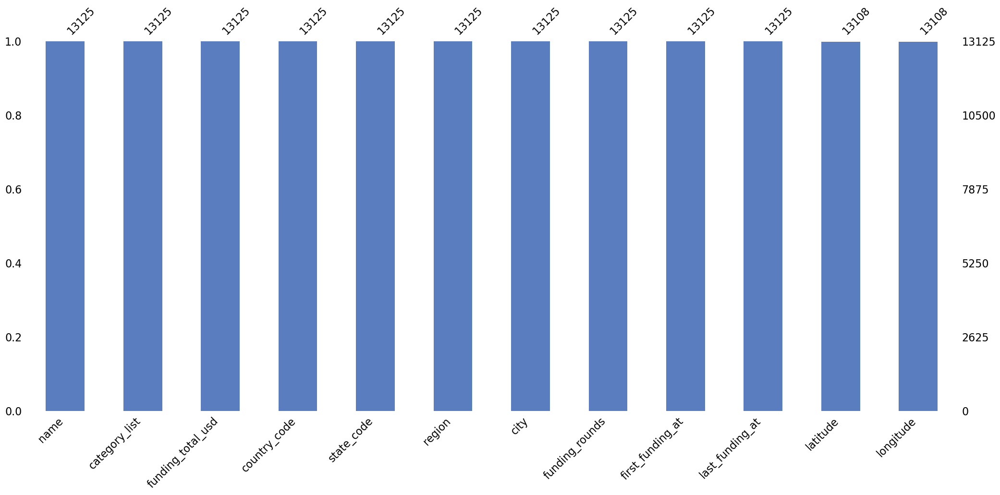

In [88]:
msno.bar(startups_test, color='#597dbf');

Заполнение пропущенных координат:

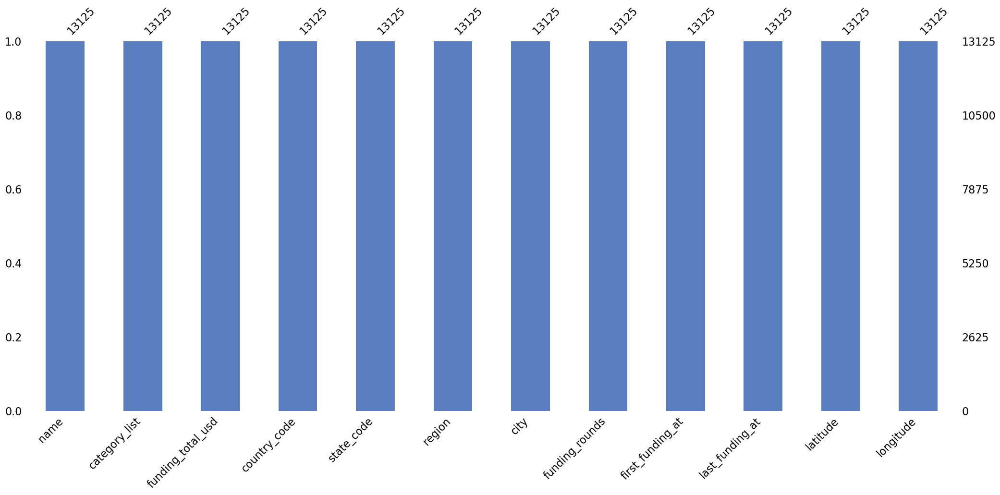

In [89]:
startups_test[['latitude', 'longitude']] = startups_test[['latitude', 'longitude']].fillna({'latitude': 0.0, 'longitude': 0.0})

# проверка
msno.bar(startups_test, color='#597dbf');

**Вывод:**

В тестовой выборке созданы новые признаки, отображающие координаты городов (`latitude` — широта, `longitude` — долгота), в которых находятся стартапы. Причем их типы данных были переведны из `float64` в `float32` для экономии вычислительной памяти, а также заполнены пропущенные значения координатами `0.0`.

### Векторизация категорий стартапов

#### Тренировочная выборка

In [90]:
# создание TF-IDF векторизатора
vectorizer = TfidfVectorizer(max_features=100)
tfidf_matrix_train = vectorizer.fit_transform(startups_train['category_list'])

# преобразование в DataFrame
tfidf_df_train = pd.DataFrame(tfidf_matrix_train.toarray(), columns=vectorizer.get_feature_names_out())

# использование PCA для уменьшения размерности до 10 признаков
pca = PCA(n_components=10)
tfidf_pca_train = pca.fit_transform(tfidf_df_train)

# преобразование в DataFrame
tfidf_pca_df_train = pd.DataFrame(tfidf_pca_train, columns=[f'category_pca_{i}' for i in range(10)])

# добавление в датафрейм
startups_train = pd.concat([startups_train, tfidf_pca_df_train], axis=1)

# проверка
startups_train.head(10)

,name,category_list,funding_total_usd,status,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,latitude,longitude,category_pca_0,category_pca_1,category_pca_2,category_pca_3,category_pca_4,category_pca_5,category_pca_6,category_pca_7,category_pca_8,category_pca_9
0,Lunchgate,Food,828626.0,operating,CHE,unknown,Zurich,Zürich,2,1304208000,1417392000,47.374451,8.541042,-0.147019,0.015926,-0.171463,-0.051750,-0.045678,-0.001969,0.009878,0.077139,-0.017657,0.013847
1,EarLens,Industry|Medicine,42935020.0,operating,USA,CA,Sf Bay Area,Redwood City,4,1272931200,1393286400,37.486324,-122.232521,-0.387305,-0.372476,0.068496,-0.029485,-0.065239,-0.027745,-0.008962,0.331098,-0.541189,-0.349135
2,Reviva Pharmaceuticals,Medicine,35456380.0,operating,USA,CA,Sf Bay Area,San Jose,3,1345420800,1404259200,37.336166,-121.890594,-0.523948,-0.668847,0.375051,0.043343,0.032514,0.009270,0.001024,-0.026938,0.008219,-0.005374
3,Sancilio and Company,Medicine,22250000.0,operating,unknown,unknown,unknown,unknown,3,1314835200,1405641600,26.492533,92.330879,-0.523948,-0.668847,0.375051,0.043343,0.032514,0.009270,0.001024,-0.026938,0.008219,-0.005374
4,WireTough Cylinders,Industry,2000000.0,operating,USA,VA,Va - Other,Bristol,1,1328054400,1328054400,51.453804,-2.597298,-0.176302,0.018789,-0.256213,-0.091571,-0.122384,-0.039955,-0.006575,0.455754,-0.673460,-0.417085
5,Connected Sports Ventures,IT,4300000.0,operating,USA,NJ,Newark,Princeton,1,1352678400,1352678400,40.349697,-74.659737,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198
6,Attensity,IT,90000000.0,operating,USA,CA,Sf Bay Area,Redwood City,1,1400025600,1400025600,37.486324,-122.232521,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198
7,Mesh Networks,IT,4300000.0,operating,USA,TX,Houston,Houston,1,1415491200,1415491200,29.758938,-95.367699,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198
8,AngioScore,Medicine,42000000.0,operating,USA,CA,Sf Bay Area,Fremont,2,1191888000,1303257600,37.548271,-121.988571,-0.523948,-0.668847,0.375051,0.043343,0.032514,0.009270,0.001024,-0.026938,0.008219,-0.005374
9,Vidatronic,Industry,1250500.0,operating,USA,TX,Austin,College Station,2,1314057600,1363824000,30.618395,-96.345596,-0.176302,0.018789,-0.256213,-0.091571,-0.122384,-0.039955,-0.006575,0.455754,-0.673460,-0.417085


**Вывод:**

В тренировочной выборке была проведена векторизация категорий с помощью TF-IDF (максимальное кол-во признаков 100) и PCA (сокращение до 10 признаков).

#### Тестовая выборка

In [91]:
# преобразование категорий в TF-IDF с уже обученным vectorizer
tfidf_matrix_test = vectorizer.transform(startups_test['category_list'])

# преобразование в DataFrame
tfidf_df_test = pd.DataFrame(tfidf_matrix_test.toarray(), columns=vectorizer.get_feature_names_out())

# уменьшение размерности с уже обученным PCA
tfidf_pca_test = pca.transform(tfidf_df_test)

# преобразование в DataFrame
tfidf_pca_df_test = pd.DataFrame(tfidf_pca_test, columns=[f'category_pca_{i}' for i in range(10)])

# добавление в датафрейм
startups_test = pd.concat([startups_test, tfidf_pca_df_test], axis=1)

# проверка
startups_test.head(10)

,name,category_list,funding_total_usd,country_code,state_code,region,city,funding_rounds,first_funding_at,last_funding_at,latitude,longitude,category_pca_0,category_pca_1,category_pca_2,category_pca_3,category_pca_4,category_pca_5,category_pca_6,category_pca_7,category_pca_8,category_pca_9
0,Crystalsol,Energy,2819200.0,NIC,unknown,unknown,unknown,1,1246406400,1246406400,26.492533,92.330879,-0.169880,0.016984,-0.231779,-0.091133,-0.091658,-0.012629,0.013460,0.238108,-0.128776,0.035283
1,JBI Fish & Wings,Real Estate,2000000.0,USA,TN,Tn - Other,Humboldt,1,1280275200,1280275200,40.599743,-123.899773,-0.165651,0.023296,-0.221001,-0.067459,-0.078946,-0.015059,0.010250,0.181425,-0.033917,0.056762
2,COINPLUS,Finance,428257.0,LUX,unknown,Esch-Sur-Alzette,Esch-Sur-Alzette,2,1400112000,1410998400,49.495964,5.985031,-0.165712,0.027293,-0.255463,-0.058324,-0.112396,-0.037849,-0.004824,0.577084,0.706896,-0.223121
3,Imagine Communications,IT|Media,34700000.0,USA,CA,San Diego,San Diego,4,1104537600,1271721600,32.717419,-117.162773,0.333367,0.440526,0.504894,-0.030407,0.074012,0.076428,-0.022564,-0.017741,-0.003705,-0.018647
4,DNA13,IT,4530000.0,CAN,unknown,Ottawa,Ottawa,1,1178582400,1178582400,45.420879,-75.690109,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198
5,Quickfire Games,Design|Entertainment,160000.0,unknown,unknown,unknown,unknown,2,1379462400,1410998400,26.492533,92.330879,-0.168648,0.052529,-0.216775,-0.091124,-0.171136,-0.163383,0.484177,-0.088610,-0.004108,-0.007868
6,Sente Inc.,Medicine,26842000.0,USA,CA,San Diego,Encinitas,5,1233360000,1401667200,33.036987,-117.291985,-0.523948,-0.668847,0.375051,0.043343,0.032514,0.009270,0.001024,-0.026938,0.008219,-0.005374
7,Triosyn,Medicine,4000000.0,unknown,unknown,unknown,unknown,1,1054512000,1054512000,26.492533,92.330879,-0.523948,-0.668847,0.375051,0.043343,0.032514,0.009270,0.001024,-0.026938,0.008219,-0.005374
8,Urgent.ly,IT,8710000.0,USA,VA,"Washington, D.C.",Sterling,3,1397692800,1443484800,31.815142,-101.045265,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198
9,Map Decisions,IT,13200.0,USA,PA,Allentown,Bethlehem,1,1376006400,1376006400,-1.450560,-48.468246,0.764914,-0.172596,0.081023,-0.011382,0.030543,0.042108,0.014075,-0.004084,-0.008052,-0.010198


**Вывод:**

В тестовой выборке была проведена векторизация категорий с помощью обученных на тренировочной выборке TF-IDF (максимальное кол-во признаков 100) и PCA (сокращение до 10 признаков).

### Вывод разработки новых синтетических признаков

#### Преобразование дат в числовой формат

В тренировочной и тестовой выборках все даты были переведены в числовой формат (секунды от эпохи Unix).

#### Получение координат городов стартапов

В тренировочной и тестовой выборках созданы новые признаки, отображающие координаты городов (`latitude` — широта, `longitude` — долгота), в которых находятся стартапы. Причем их типы данных были переведны из `float64` в `float32` для экономии вычислительной памяти, а также заполнены пропущенные значения координатами `0.0`.

#### Векторизация категорий стартапов

В тренировочной и тестовой выборках была проведена векторизация категорий с помощью TF-IDF (максимальное кол-во признаков 100) и PCA (сокращение до 10 признаков).

## Проверка на мультиколлинеарность

Построение тепловой карты:

In [92]:
# числовые столбцы
num_cols = list(startups_train.select_dtypes(include=['number']).columns)

# построение корр. тепловой карты
vif_heatmap(
    df=startups_train[num_cols],
    t='Тепловая карта VIF тренировочной выборки'
)

Создание нового признака на основе дат первого и последнего раундов финансирования:

In [93]:
# кол-во секунд в году
SECONDS_IN_YEAR = 31_536_000

# вычисление длительности финансирования
startups_train['funding_duration'] = (startups_train['last_funding_at'] - startups_train['first_funding_at']) / SECONDS_IN_YEAR
startups_test['funding_duration'] = (startups_test['last_funding_at'] - startups_test['first_funding_at']) / SECONDS_IN_YEAR

# проверка
display(startups_train[['last_funding_at', 'first_funding_at', 'funding_duration']].head(10))
display(startups_test[['last_funding_at', 'first_funding_at', 'funding_duration']].head(10))

,last_funding_at,first_funding_at,funding_duration
0,1417392000,1304208000,3.589041
1,1393286400,1272931200,3.816438
2,1404259200,1345420800,1.865753
3,1405641600,1314835200,2.879452
4,1328054400,1328054400,0.000000
5,1352678400,1352678400,0.000000
6,1400025600,1400025600,0.000000
7,1415491200,1415491200,0.000000
8,1303257600,1191888000,3.531507
9,1363824000,1314057600,1.578082


,last_funding_at,first_funding_at,funding_duration
0,1246406400,1246406400,0.000000
1,1280275200,1280275200,0.000000
2,1410998400,1400112000,0.345205
3,1271721600,1104537600,5.301370
4,1178582400,1178582400,0.000000
5,1410998400,1379462400,1.000000
6,1401667200,1233360000,5.336986
7,1054512000,1054512000,0.000000
8,1443484800,1397692800,1.452055
9,1376006400,1376006400,0.000000


Удаление дат первого и последнего раундов финансирования:

In [94]:
startups_train.drop(columns=['last_funding_at', 'first_funding_at'], inplace=True)
startups_test.drop(columns=['last_funding_at', 'first_funding_at'], inplace=True)

# проверка
startups_train.columns

Index(['name', 'category_list', 'funding_total_usd', 'status', 'country_code',
       'state_code', 'region', 'city', 'funding_rounds', 'latitude',
       'longitude', 'category_pca_0', 'category_pca_1', 'category_pca_2',
       'category_pca_3', 'category_pca_4', 'category_pca_5', 'category_pca_6',
       'category_pca_7', 'category_pca_8', 'category_pca_9',
       'funding_duration'],
      dtype='object')

Проверка:

In [95]:
# числовые столбцы
num_cols = list(startups_train.select_dtypes(include=['number']).columns)

# построение корр. тепловой карты
vif_heatmap(
    df=startups_train[num_cols],
    t='Тепловая карта VIF тренировочной выборки после устранения мультиколлинеарности'
)

**Вывод:**

С помощью коэффициента VIF была выявлена мультиколлинеарность между `first_funding_at` (1208.433) и `last_funding_at` (1325.853), так как это может сказаться на итоговом качестве модели, то было решено создать новый признак на основе дат первого и последнего раундов финансирования, а именно вычислить длительность финансирования.

## Построение моделей машинного обучения

### Создание выборок

Целевой признак:

In [96]:
# определение целевого признака
target_col = 'status'

# вывод целевого признака
print(f'Целевой признак:\n{target_col}\n')

Целевой признак:
status



Входные признаки:

In [97]:
# числовые входные признаки
num_cols = list(startups_train.select_dtypes(include=[np.number]))

# вывод входных признаков
print(f'Числовые входные признаки:\n{num_cols}\n')

Числовые входные признаки:
['funding_total_usd', 'funding_rounds', 'latitude', 'longitude', 'category_pca_0', 'category_pca_1', 'category_pca_2', 'category_pca_3', 'category_pca_4', 'category_pca_5', 'category_pca_6', 'category_pca_7', 'category_pca_8', 'category_pca_9', 'funding_duration']



Кодирование целевого признака:

In [98]:
# входные признаки
X_train_val = startups_train[num_cols]
X_test = startups_test[num_cols]

# кодирование целевого признака
label_encoder = LabelEncoder()
label_encoder.fit(['closed', 'operating'])
y_train_val = label_encoder.transform(startups_train[target_col])

# проверка кодирования целевого признака
print('Целевой признак закодирован следующим образом:')
print(f'0 - {list(label_encoder.classes_)[0]}')
print(f'1 - {list(label_encoder.classes_)[1]}')

Целевой признак закодирован следующим образом:
0 - closed
1 - operating


Разделение на обучающую и валидационные выборки:

In [99]:
X_train, X_val, y_train, y_val = train_test_split(
    X_train_val,
    y_train_val,
    random_state=RANDOM_STATE,
    test_size=0.25,
    stratify=y_train_val
)

Андерсэплинг обучающей выборки:

In [100]:
# экземпляр сэмплера
sampler = SMOTE(random_state=RANDOM_STATE, k_neighbors=5)

# сэмплирование данных
X_train, y_train = sampler.fit_resample(X_train, y_train)

# проверка
pie_plot(
    df=pd.DataFrame(y_train, columns=['status']).replace({0: 'closed', 1: 'operating'}),
    col='status',
    lt='Статусы',
    t='Распределение статусов стартапов в тренировочной и валидационной выборке после устранения дисбаланса'
)

Размеры выборок:

In [101]:
print(f'Размеры тренировочной выборки: входные признаки - {X_train.shape}, целевой признак - {y_train.shape}')
print(f'Размеры валидационной выборки: входные признаки - {X_val.shape}, целевой признак - {y_val.shape}')
print(f'Размеры тестовой выборки: входные признаки - {X_test.shape}')

Размеры тренировочной выборки: входные признаки - (71290, 15), целевой признак - (71290,)
Размеры валидационной выборки: входные признаки - (13110, 15), целевой признак - (13110,)
Размеры тестовой выборки: входные признаки - (13125, 15)


**Вывод:**

В качестве целевого признака был выбран статус стартапов (`status`), а в качестве входных: общая сумма финансирования (`funding_total_usd`), кол-во раундов финансирования (`funding_rounds`), длительность финансирования (`funding_duration`), широта (`latitude`), долгота (`longitude`), PCA-признаки (`category_pca_0`, `category_pca_1`, `category_pca_2`, `category_pca_3`, `category_pca_4`, `category_pca_5`, `category_pca_6`, `category_pca_7`, `category_pca_8`, `category_pca_9`).

Для дальнейшего обучения моделей было произведено кодирование (`label encoder`) целевого признака: закрывшийся стартап обозначается как `0` (`closed`), а действующий — как `1` (`operating`).

Так как в обучающей выборке наблюдался огромный дисбаланс категорий целевого признака, то было решено его устранить с помощью метода `SMOTE` (кол-во соседей — 5). В валидационной же выборке дисбаланс сохранился для приближения к реальным данным.

В итоге, получились следующие выборки:

- тренировочная выборка: входные признаки имеют 71 290 строк и 15 столбцов (`X_train`), а целевой — 71 290 строк (`y_train`);
- валидационная выборка: входные признаки имеют 13 110 строк и 15 столбцов (`X_val`), а целевой — 13 110 строк (`y_val`);
- тестовая выборка: входные признаки имеют 13 125 строк и 15 столбцов (`X_test`).

### Подбор моделей и их гиперпараметров

Словарь для хранения результатов:

In [102]:
results_models = {}

#### Простые модели

In [103]:
def simple_models(trial):
    '''Функция для оптимизации гиперпараметров простых моделей.'''

    # отсчет времени
    start_time = time.time()
    
    # выбор модели
    model_name = trial.suggest_categorical(
        'model',
        ['logreg_l1', 'logreg_l2', 'decision_tree', 'svm', 'knn', 'random_forest']
    )

    # выбор предобработчика
    preprocessor_name = trial.suggest_categorical(
        'preprocessor',
        ['passthrough', 'standard', 'minmax', 'robust']
    )
    
    # создание объекта препроцессора
    if preprocessor_name == 'standard':
        preprocessor = StandardScaler()
    elif preprocessor_name == 'minmax':
        preprocessor = MinMaxScaler()
    elif preprocessor_name == 'robust':
        preprocessor = RobustScaler()
    else:
        preprocessor = 'passthrough'
    
    # логистическая регрессия
    if 'logreg' in model_name:
        C = trial.suggest_float('C', 1e-3, 1e2, log=True) # обратный коэффициент регуляризации
        penalty = 'l1' if model_name == 'logreg_l1' else 'l2' # вид регуляризации
        model = LogisticRegression(
            C=C,
            penalty=penalty,
            solver='liblinear',
            max_iter=5000,
            random_state=RANDOM_STATE
        )

    # метод опорных векторов
    elif model_name == 'svm':
        C = trial.suggest_float('C', 1e-3, 1e2, log=True) # обратный коэффициент регуляризации
        model = LinearSVC(
            C=C,
            dual=False,
            max_iter=5000,
            random_state=RANDOM_STATE
        )
    
    # k-ближайших соседей
    elif model_name == 'knn':
        n_neighbors = trial.suggest_int('n_neighbors', 1, 30) # кол-во соседей
        weights = trial.suggest_categorical('weights', ['uniform', 'distance']) # веса
        model = KNeighborsClassifier(n_neighbors=n_neighbors, weights=weights)

    # дерево решений
    elif model_name == 'decision_tree':
        max_depth = trial.suggest_int('max_depth', 2, 20) # максимальная глубина дерева
        min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # минимальное кол-во объектов в узле
        min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # минимальное кол-во объектов в листе
        model = DecisionTreeClassifier(
            max_depth=max_depth,
            min_samples_split=min_samples_split,
            min_samples_leaf=min_samples_leaf,
            random_state=RANDOM_STATE
        )
    
    # случайный лес
    elif model_name == 'random_forest':
        n_estimators = trial.suggest_int('n_estimators', 50, 500) # кол-во деревьев
        max_depth = trial.suggest_int('max_depth', 2, 20) # максимальная глубина дерева
        min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # минимальное кол-во объектов в узле
        min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # минимальное кол-во объектов в листе
        model = RandomForestClassifier(
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_samples_split=min_samples_split,
            min_samples_leaf=min_samples_leaf,
            random_state=RANDOM_STATE,
            n_jobs=-1
        )
    
    # создание пайплайна
    pipe = Pipeline([
        ('preprocessor', preprocessor),
        ('model', model)
    ])

    # кросс-валидация
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)
    score = cross_val_score(pipe, X_train, y_train, scoring='f1', cv=cv, n_jobs=1).mean()

    # подсчет времени выполнения
    elapsed_time = round(time.time() - start_time, 2)
    
    # сохранение результата в словарь
    if model_name not in results_models or score > results_models[model_name]['best_score']:
        results_models[model_name] = {
            'best_params': trial.params,
            'best_score': score,
            'time_taken': elapsed_time
        }
    
    return score

**Вывод:**

Для подготовки данных простым моделям были выбраны следующие методы масштабирования: `StandardScaler`, `MinMaxScaler` и `RobustScaler`.

Для задачи классификации было выбрано 6 простых моделей машинного обучения:

- логистическая регрессия с L1-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- логистическая регрессия с L2-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- метод опорных векторов с гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация);
- k-ближайших соседей с гиперпараметрами: кол-во соседей от 1 до 30 (`n_neighbors`), равные (`uniform`) и обратные (`distance`) веса (`weights`);
- дерево решений с гиперпараметрами: максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`);
- случайный лес с гиперпараметрами: кол-во деревьев от 50 до 500 (`n_estimators`), максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`).

#### Градиентный бустинг `LightGBM`

In [104]:
def lightgbm_models(trial):
    '''Функция для оптимизации гиперпараметров LightGBM.'''

    # отсчет времени
    start_time = time.time()
    
    # задание гиперпараметров для LightGBM
    params = {
        'objective': 'binary',  # бинарная классификация
        'num_leaves': trial.suggest_int('num_leaves', 10, 80), # максимальное кол-во листьев в дереве
        'min_child_samples': trial.suggest_int('min_child_samples', 5, 50), # минимальное кол-во объектов в листе
        'max_depth': trial.suggest_int('max_depth', 3, 10), # максимальная глубина дерева
        'n_estimators': trial.suggest_int('n_estimators', 100, 300), # кол-во деревьев
        'learning_rate': trial.suggest_float('learning_rate', 1e-2, 1e-1, log=True), # шаг градиентного спуска

        # регуляризация
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-3, 1e-1, log=True), # L1-регуляризация
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 1e-1, log=True), # L2-регуляризация
        
        # оптимизация GPU
        'device': 'gpu', # использование GPU
        'gpu_use_dp': False, # False - FP16 (быстрее), True - FP32 (точнее)
        
        # отключение логов
        'verbose': -1,
        'verbosity': -1,

        # фиксация случайности
        'random_state': RANDOM_STATE
    }

    # создание модели
    model = lgb.LGBMClassifier(**params)

    # кросс-валидация
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)
    score = cross_val_score(model, X_train, y_train, scoring='f1', cv=cv, n_jobs=1).mean()

    # подсчет времени выполнения
    elapsed_time = round(time.time() - start_time, 2)

    # сохранение результата в словарь
    model_name = 'lightgbm'
    if model_name not in results_models or score > results_models[model_name]['best_score']:
        results_models[model_name] = {
            'best_params': trial.params,
            'best_score': score,
            'time_taken': elapsed_time
        }
    
    return score

**Вывод:**

Для градиентного бустинга `LightGBM` будут использоваться следующие гиперпараметры:

- оптимизация для бинарной классификации (`objective`);
- максимальное кол-во листьев в дереве: от 10 до 80 (`num_leaves`);
- минимальное кол-во объектов в листе: от 5 до 50 (`min_child_samples`);
- максимальная глубина дерева: от 3 до 10 (`max_depth`);
- кол-во деревьев: от 100 до 300 (`n_estimators`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L1-регуляризация: от 0.001 до 0.1 (`reg_alpha`);
- L2-регуляризация: от 0.001 до 0.1 (`reg_lambda`)
- оптимизация GPU (`task_type`).

#### Градиентный бустинг `CatBoost`

In [105]:
def cat_models(trial):
    '''Функция для оптимизации гиперпараметров CatBoost.'''

    # отсчет времени
    start_time = time.time()
    
    # задание гиперпараметров для CatBoost
    params = {
        'depth': trial.suggest_int('depth', 3, 10), # глубина деревьев
        'iterations': trial.suggest_int('iterations', 100, 300), # кол-во деревьев
        'learning_rate': trial.suggest_float('learning_rate', 1e-2, 1e-1, log=True), # шаг градиентного спуска

        # регуляризация
        'l2_leaf_reg': trial.suggest_float('l2_leaf_reg', 1e-2, 1e-1, log=True), # L2-регуляризация

        # дополнительные параметры
        'bootstrap_type': 'Bernoulli', # быстрый бутстреп
        'subsample': trial.suggest_float('subsample', 0.5, 0.9), # 50-90% данных в каждом дереве
        'border_count': trial.suggest_int('border_count', 32, 128), # упрощенная дискретизация
        'grow_policy': 'Lossguide', # быстрое построение деревьев
        'early_stopping_rounds': 50, # остановка обучения, если нет улучшения за 50 итераций
        
        # оптимизация GPU
        'task_type': 'GPU',

        # отключение логов
        'verbose': 0,

        # фиксация случайности
        'random_seed': RANDOM_STATE
    }

    # создание модели
    model = CatBoostClassifier(**params)

    # кросс-валидация
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=RANDOM_STATE)
    score = cross_val_score(model, X_train, y_train, scoring='f1', cv=cv, n_jobs=1).mean()

    # подсчет времени выполнения
    elapsed_time = round(time.time() - start_time, 2)

    # сохранение результата в словарь
    model_name = 'catboost'
    if model_name not in results_models or score > results_models[model_name]['best_score']:
        results_models[model_name] = {
            'best_params': trial.params,
            'best_score': score,
            'time_taken': elapsed_time
        }

    return score

**Вывод:**

Для градиентного бустинга `CatBoost` будут использоваться следующие гиперпараметры:

- максимальная глубина дерева: от 3 до 10 (`depth`);
- кол-во деревьев: от 100 до 300 (`iterations`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L2-регуляризация: от 0.001 до 0.1 (`l2_leaf_reg`);
- быстрый бутстреп `Bernoulli` (`bootstrap_type`);
- 50-90% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: от 32 до 128 (`border_count`);
- быстрое построение деревьев с помощью алгоритма `Lossguide` (`grow_policy`);
- остановка обучения, если нет улучшения за 50 итераций (`early_stopping_rounds`)
- оптимизация GPU (`task_type`).

### Обучение и валидация

#### Простые модели

Поиск лучших гиперпараметров с помощью кросс-валидации `Optuna`:

In [106]:
# запуск кросс-валидации optuna
study_sm = optuna.create_study(
    direction='maximize',
    sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE)
)
study_sm.optimize(simple_models, n_trials=50)

# вывод результатов по каждой модели
print('РЕЗУЛЬТАТЫ ПО МОДЕЛЯМ:')
for model, info in results_models.items():
    print(f'\n{model}')
    print(f'Лучшая метрика (F1): {info["best_score"]:.4f}')
    print(f'Лучшие гиперпараметры: {info["best_params"]}')
    print(f'Время выполнения: {info["time_taken"]} сек.')

РЕЗУЛЬТАТЫ ПО МОДЕЛЯМ:

logreg_l2
Лучшая метрика (F1): 0.6667
Лучшие гиперпараметры: {'model': 'logreg_l2', 'preprocessor': 'passthrough', 'C': 0.9761125443110458}
Время выполнения: 0.29 сек.

logreg_l1
Лучшая метрика (F1): 0.6522
Лучшие гиперпараметры: {'model': 'logreg_l1', 'preprocessor': 'robust', 'C': 6.198769542203979}
Время выполнения: 0.59 сек.

svm
Лучшая метрика (F1): 0.6589
Лучшие гиперпараметры: {'model': 'svm', 'preprocessor': 'minmax', 'C': 0.0021147447960615704}
Время выполнения: 0.6 сек.

random_forest
Лучшая метрика (F1): 0.8997
Лучшие гиперпараметры: {'model': 'random_forest', 'preprocessor': 'minmax', 'n_estimators': 485, 'max_depth': 18, 'min_samples_split': 15, 'min_samples_leaf': 7}
Время выполнения: 22.03 сек.

decision_tree
Лучшая метрика (F1): 0.8727
Лучшие гиперпараметры: {'model': 'decision_tree', 'preprocessor': 'minmax', 'max_depth': 20, 'min_samples_split': 18, 'min_samples_leaf': 3}
Время выполнения: 2.54 сек.

knn
Лучшая метрика (F1): 0.8362
Лучшие гипер

Обучение и валидация лучшей модели:

In [107]:
# лучшие гиперпараметры
best_params_sm = study_sm.best_params.copy()
excluded_params = {'model', 'preprocessor'}
best_params_sm = {k: v for k, v in best_params_sm.items() if k not in excluded_params}

# лучшая модель
best_sm = Pipeline([
    ('preprocessor', MinMaxScaler()),
    ('model', RandomForestClassifier(**best_params_sm))
])

# обучение и валидация лучшей модели
best_sm, y_pred_val_sm, y_pred_val_sm_proba = train_val_best_model(
    pipe=best_sm,
    X_tr=X_train,
    y_tr=y_train,
    X_va=X_val,
    y_va=y_val
)

F1-score на валидации: 0.9249
Время обучения: 46.46 сек.
Скорость предсказания: 22807.04 предск./сек.


**Вывод:**

Кросс-валидация с помощью `Optuna` показала, что среди всех простых моделей лучшей оказался случайный лес со следующими гиперпараметрами:

- предобработка: `MinMaxScaler`;
- кол-во деревьев: 485 (`n_estimators`);
- максимальная глубина дерева: 18 (`max_depth`);
- минимальное кол-во объектов в узле: 15 (`min_samples_split`);
- минимальное кол-во объектов в листе: 7 (`min_samples_leaf`).

Метрика $F1$ лучшего дерева решений на валидационных данных составляет 0.92, при этом время обучения равняется 46.46 сек., а скорость предсказания — 22 807 предск./сек..

#### Градиентный бустинг `LightGBM`

Поиск лучших гиперпараметров с помощью кросс-валидации `Optuna`:

In [108]:
# запуск кросс-валидации optuna
study_lgbm = optuna.create_study(
    direction='maximize',
    sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE)
)
study_lgbm.optimize(lightgbm_models, n_trials=50)

# вывод результатов
print(f'Лучшая метрика (F1): {results_models["lightgbm"]["best_score"]:.4f}')
print(f'Лучшие гиперпараметры: {results_models["lightgbm"]["best_params"]}')
print(f'Время выполнения: {results_models["lightgbm"]["time_taken"]} сек.')

Лучшая метрика (F1): 0.9162
Лучшие гиперпараметры: {'num_leaves': 66, 'min_child_samples': 15, 'max_depth': 10, 'n_estimators': 231, 'learning_rate': 0.09991782496223989, 'reg_alpha': 0.05085985670233094, 'reg_lambda': 0.0010052495611771978}
Время выполнения: 12.01 сек.


Обучение и валидация лучшей модели:

In [109]:
# лучшие гиперпараметры
best_params_lgbm = study_lgbm.best_params.copy()

# лучшая модель
best_lgbm = lgb.LGBMClassifier(**best_params_lgbm)

# обучение и валидация лучшей модели
best_lgbm, y_pred_val_lgbm, y_pred_val_lgbm_proba = train_val_best_model(
    pipe=best_lgbm,
    X_tr=X_train,
    y_tr=y_train,
    X_va=X_val,
    y_va=y_val
)

F1-score на валидации: 0.9280
Время обучения: 0.54 сек.
Скорость предсказания: 336149.44 предск./сек.


**Вывод:**

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `LightGBM` является модель со следующими гиперпараметрами:

- максимальное кол-во листьев в дереве: 66 (`num_leaves`);
- минимальное кол-во объектов в листе: 15 (`min_child_samples`);
- максимальная глубина дерева: 10 (`max_depth`);
- кол-во деревьев: 231 (`n_estimators`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L1-регуляризация: 0.051 (`reg_alpha`);
- L2-регуляризация: 0.001 (`reg_lambda`).

Метрика $F1$ лучшего градиентного бустинга `LightGBM` на валидационных данных составляет 0.93, при этом время обучения равняется 0.54 сек., а скорость предсказания — 336 149 предск./сек..

#### Градиентный бустинг `CatBoost`

Поиск лучших гиперпараметров с помощью кросс-валидации `Optuna`:

In [110]:
# запуск кросс-валидации optuna
study_cat = optuna.create_study(
    direction='maximize',
    sampler=optuna.samplers.TPESampler(seed=RANDOM_STATE)
)
study_cat.optimize(cat_models, n_trials=50)

# вывод результатов
print(f'Лучшая метрика (F1): {results_models["catboost"]["best_score"]:.4f}')
print(f'Лучшие гиперпараметры: {results_models["catboost"]["best_params"]}')
print(f'Время выполнения: {results_models["catboost"]["time_taken"]} сек.')

Лучшая метрика (F1): 0.9111
Лучшие гиперпараметры: {'depth': 7, 'iterations': 291, 'learning_rate': 0.09977199163639669, 'l2_leaf_reg': 0.025602809850692586, 'subsample': 0.5026295732665302, 'border_count': 126}
Время выполнения: 16.34 сек.


Обучение и валидация лучшей модели:

In [112]:
# лучшие гиперпараметры
best_params_cat = study_cat.best_params.copy()

# лучшая модель
best_cat = CatBoostClassifier(**best_params_cat, verbose=0)

# обучение и валидация лучшей модели
best_cat, y_pred_val_cat, y_pred_val_cat_proba = train_val_best_model(
    pipe=best_cat,
    X_tr=X_train,
    y_tr=y_train,
    X_va=X_val,
    y_va=y_val
)

F1-score на валидации: 0.9270
Время обучения: 3.64 сек.
Скорость предсказания: 467444.15 предск./сек.


**Вывод:**

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `CatBoost` является модель со следующими гиперпараметрами:

- максимальная глубина дерева: 7 (`depth`);
- кол-во деревьев: 291 (`iterations`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L2-регуляризация: 0.026 (`l2_leaf_reg`);
- 50% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: 126 (`border_count`).

Метрика $F1$ лучшего градиентного бустинга `CatBoost` на валидационных данных составляет 0.93, при этом время обучения равняется 3.64 сек., а скорость предсказания — 467 444 предск./сек..

### Анализ моделей

#### Случайный лес

Матрица ошибок:

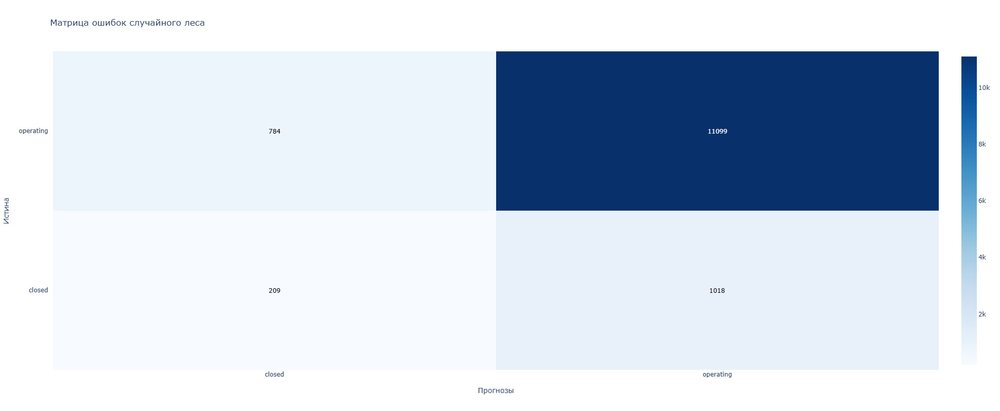

In [113]:
conf_matrix(
    y_tr=y_val,
    y_pr=y_pred_val_sm,
    le=label_encoder,
    t='Матрица ошибок случайного леса'
)

Вывод стандартных метрик:

In [114]:
standard_metrics('class', y_val, y_pred_val_sm)

accuracy = 86%
precision = 92%
recall = 93%


**Вывод:**

Матрица ошибок случайного леса имеет следующий вид:

- 209 закрывшихся стартапов были верно классифицированы (TN),
- 1 018 закрывшихся стартапов были неверно классифицированы (FN),
- 11 099 действующих стартапов были верно классифицированы (TP),
- 784 действующих стартапа были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 86% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 93% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

#### Градиентный бустинг `LightGBM`

Матрица ошибок:

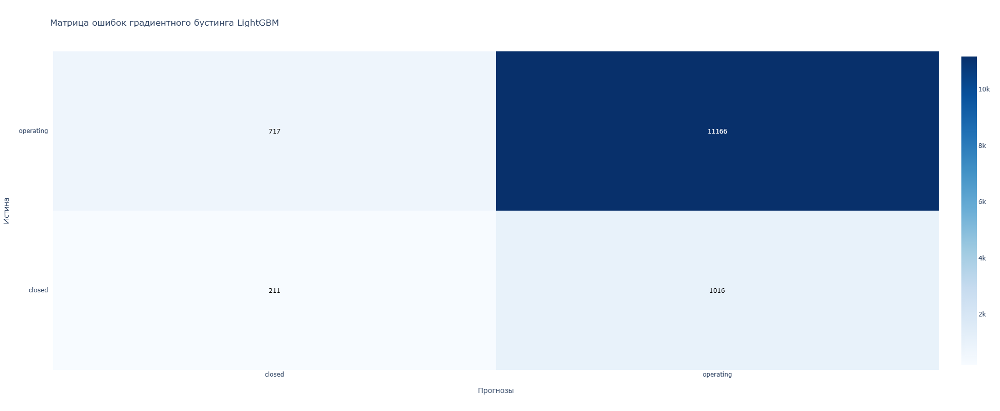

In [115]:
conf_matrix(
    y_tr=y_val,
    y_pr=y_pred_val_lgbm,
    le=label_encoder,
    t='Матрица ошибок градиентного бустинга LightGBM'
)

Вывод стандартных метрик:

In [116]:
standard_metrics('class', y_val, y_pred_val_lgbm)

accuracy = 87%
precision = 92%
recall = 94%


**Вывод:**

Матрица ошибок градиентного бустинга `LightGBM` имеет следующий вид:

- 211 закрывшихся стартапов были верно классифицированы (TN),
- 1 016 закрывшихся стартапов были неверно классифицированы (FN),
- 11 166 действующих стартапов были верно классифицированы (TP),
- 717 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

#### Градиентный бустинг `CatBoost`

Матрица ошибок:

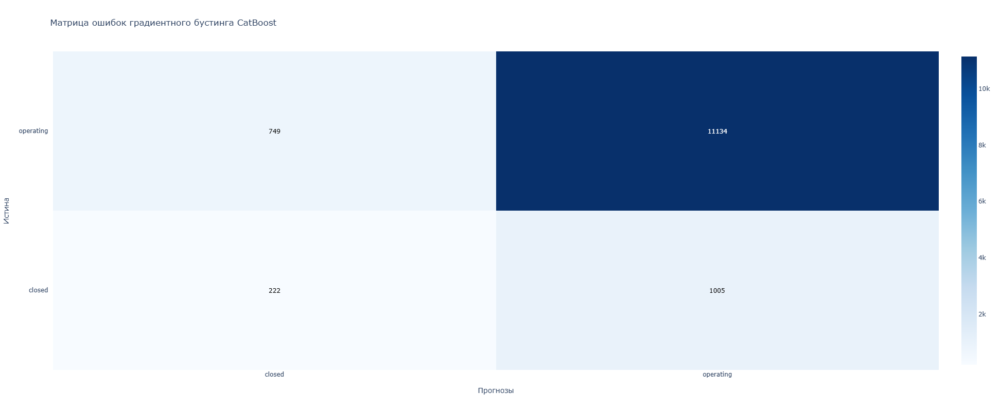

In [117]:
conf_matrix(
    y_tr=y_val,
    y_pr=y_pred_val_cat,
    le=label_encoder,
    t='Матрица ошибок градиентного бустинга CatBoost'
)

Вывод стандартных метрик:

In [118]:
standard_metrics('class', y_val, y_pred_val_cat)

accuracy = 87%
precision = 92%
recall = 94%


**Вывод:**

Матрица ошибок градиентного бустинга `CatBoost` имеет следующий вид:

- 222 закрывшихся стартапа были верно классифицированы (TN),
- 1 005 закрывшихся стартапов были неверно классифицированы (FN),
- 11 134 действующих стартапа были верно классифицированы (TP),
- 749 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

### Вывод построения моделей машинного обучения

#### Создание выборок

В качестве целевого признака был выбран статус стартапов (`status`), а в качестве входных: общая сумма финансирования (`funding_total_usd`), кол-во раундов финансирования (`funding_rounds`), длительность финансирования (`funding_duration`), широта (`latitude`), долгота (`longitude`), PCA-признаки (`category_pca_0`, `category_pca_1`, `category_pca_2`, `category_pca_3`, `category_pca_4`, `category_pca_5`, `category_pca_6`, `category_pca_7`, `category_pca_8`, `category_pca_9`).

Для дальнейшего обучения моделей было произведено кодирование (`label encoder`) целевого признака: закрывшийся стартап обозначается как `0` (`closed`), а действующий — как `1` (`operating`).

Так как в обучающей выборке наблюдался огромный дисбаланс категорий целевого признака, то было решено его устранить с помощью метода `SMOTE` (кол-во соседей — 5). В валидационной же выборке дисбаланс сохранился для приближения к реальным данным.

В итоге, получились следующие выборки:

- тренировочная выборка: входные признаки имеют 71 290 строк и 15 столбцов (`X_train`), а целевой — 71 290 строк (`y_train`);
- валидационная выборка: входные признаки имеют 13 110 строк и 15 столбцов (`X_val`), а целевой — 13 110 строк (`y_val`);
- тестовая выборка: входные признаки имеют 13 125 строк и 15 столбцов (`X_test`).

#### Подбор моеделй и их гиперпараметров

Для подготовки данных простым моделям были выбраны следующие методы масштабирования: `StandardScaler`, `MinMaxScaler` и `RobustScaler`.

Для задачи классификации было выбрано 6 простых моделей машинного обучения:

- логистическая регрессия с L1-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- логистическая регрессия с L2-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- метод опорных векторов с гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация);
- k-ближайших соседей с гиперпараметрами: кол-во соседей от 1 до 30 (`n_neighbors`), равные (`uniform`) и обратные (`distance`) веса (`weights`);
- дерево решений с гиперпараметрами: максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`);
- случайный лес с гиперпараметрами: кол-во деревьев от 50 до 500 (`n_estimators`), максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`).

Для градиентного бустинга `LightGBM` будут использоваться следующие гиперпараметры:

- оптимизация для бинарной классификации (`objective`);
- максимальное кол-во листьев в дереве: от 10 до 80 (`num_leaves`);
- минимальное кол-во объектов в листе: от 5 до 50 (`min_child_samples`);
- максимальная глубина дерева: от 3 до 10 (`max_depth`);
- кол-во деревьев: от 100 до 300 (`n_estimators`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L1-регуляризация: от 0.001 до 0.1 (`reg_alpha`);
- L2-регуляризация: от 0.001 до 0.1 (`reg_lambda`)
- оптимизация GPU (`task_type`).

Для градиентного бустинга `CatBoost` будут использоваться следующие гиперпараметры:

- максимальная глубина дерева: от 3 до 10 (`depth`);
- кол-во деревьев: от 100 до 300 (`iterations`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L2-регуляризация: от 0.001 до 0.1 (`l2_leaf_reg`);
- быстрый бутстреп `Bernoulli` (`bootstrap_type`);
- 50-90% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: от 32 до 128 (`border_count`);
- быстрое построение деревьев с помощью алгоритма `Lossguide` (`grow_policy`);
- остановка обучения, если нет улучшения за 50 итераций (`early_stopping_rounds`)
- оптимизация GPU (`task_type`).

#### Обучение и валидация

Кросс-валидация с помощью `Optuna` показала, что среди всех простых моделей лучшей оказался случайный лес со следующими гиперпараметрами:

- предобработка: `MinMaxScaler`;
- кол-во деревьев: 485 (`n_estimators`);
- максимальная глубина дерева: 18 (`max_depth`);
- минимальное кол-во объектов в узле: 15 (`min_samples_split`);
- минимальное кол-во объектов в листе: 7 (`min_samples_leaf`).

Метрика $F1$ лучшего дерева решений на валидационных данных составляет 0.92, при этом время обучения равняется 46.46 сек., а скорость предсказания — 22 807 предск./сек..

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `LightGBM` является модель со следующими гиперпараметрами:

- максимальное кол-во листьев в дереве: 66 (`num_leaves`);
- минимальное кол-во объектов в листе: 15 (`min_child_samples`);
- максимальная глубина дерева: 10 (`max_depth`);
- кол-во деревьев: 231 (`n_estimators`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L1-регуляризация: 0.051 (`reg_alpha`);
- L2-регуляризация: 0.001 (`reg_lambda`).

Метрика $F1$ лучшего градиентного бустинга `LightGBM` на валидационных данных составляет 0.93, при этом время обучения равняется 0.54 сек., а скорость предсказания — 336 149 предск./сек..

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `CatBoost` является модель со следующими гиперпараметрами:

- максимальная глубина дерева: 7 (`depth`);
- кол-во деревьев: 291 (`iterations`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L2-регуляризация: 0.026 (`l2_leaf_reg`);
- 50% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: 126 (`border_count`).

Метрика $F1$ лучшего градиентного бустинга `CatBoost` на валидационных данных составляет 0.93, при этом время обучения равняется 3.64 сек., а скорость предсказания — 467 444 предск./сек..

#### Анализ моделей

Матрица ошибок случайного леса имеет следующий вид:

- 209 закрывшихся стартапов были верно классифицированы (TN),
- 1 018 закрывшихся стартапов были неверно классифицированы (FN),
- 11 099 действующих стартапов были верно классифицированы (TP),
- 784 действующих стартапа были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 86% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 93% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

Матрица ошибок градиентного бустинга `LightGBM` имеет следующий вид:

- 211 закрывшихся стартапов были верно классифицированы (TN),
- 1 016 закрывшихся стартапов были неверно классифицированы (FN),
- 11 166 действующих стартапов были верно классифицированы (TP),
- 717 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

Матрица ошибок градиентного бустинга `CatBoost` имеет следующий вид:

- 222 закрывшихся стартапа были верно классифицированы (TN),
- 1 005 закрывшихся стартапов были неверно классифицированы (FN),
- 11 134 действующих стартапа были верно классифицированы (TP),
- 749 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

#### Выбор лучшей модели

По итогу, лучшей моделью оказался градиентный бустинг `Catboost`, поскольку у него лучший результат по метрике $F1$ (0.93), recall (94%) и скорости предсказания на валидационных данных, хотя и уступает во времени обучения градиентному бустингу `LightGBM`.

## Анализ важности признаков лучшей модели

### График важности SHAP в виде плотбара

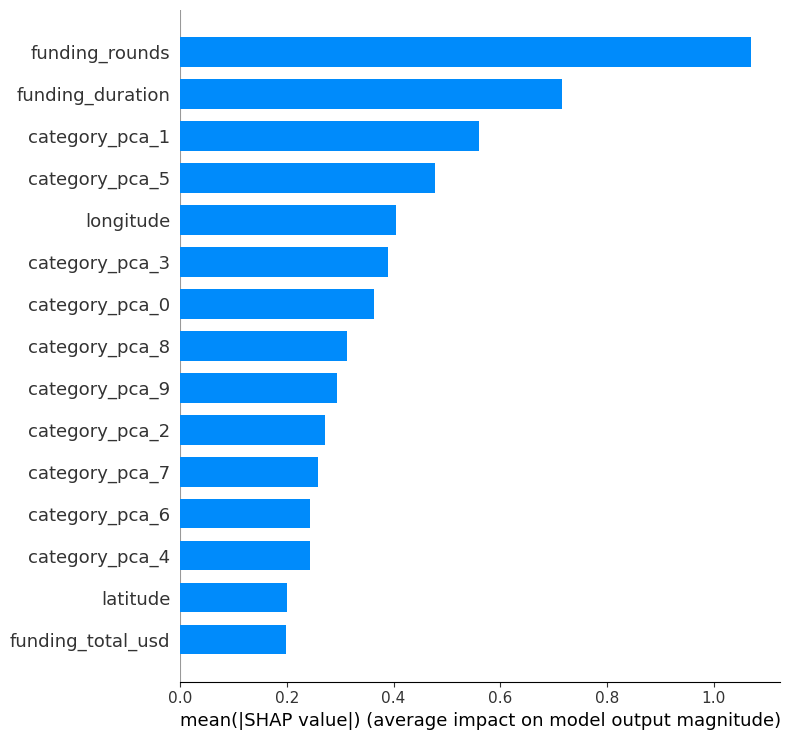

In [119]:
# создание объекта KernelExplainer для извлеченной модели
explainer = shap.TreeExplainer(best_cat)

# вычисление SHAP значений
shap_values = explainer.shap_values(X_val)

# построение плотбара
shap.summary_plot(shap_values, X_val, plot_type='bar')

**Вывод:**

С точки зрения лучшей модели и согласно графику важности SHAP в виде плотбара, входные признаки можно разделить на:

- **значимые**: кол-во раундов финансирования (`funding_rounds`);
- **малозначимые**: длительность финансирования (`funding_duration`), категория стартапа (`category_list`);
- **незначимые**: долгота (`longitude`), широта (`latitude`), общая сумма финансирования (`funding_total_usd`).

### График важности SHAP в виде beeswarm

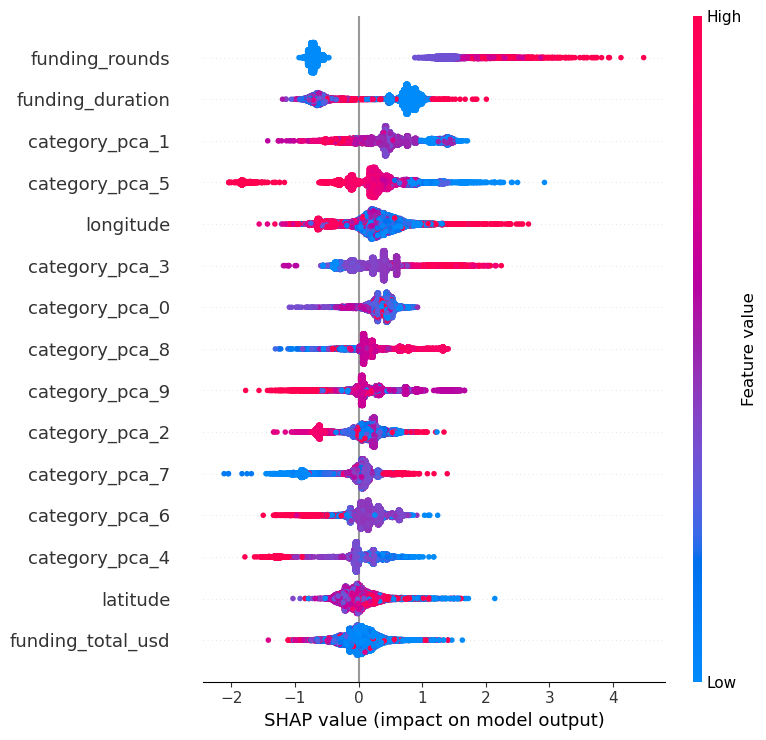

In [120]:
shap.summary_plot(shap_values, X_val)

**Вывод:**

Согласно графику важности SHAP в виде beeswarm, лучшая модель говорит о том, что низкие значения кол-ва раундов финансирования влияют на определение закрывающихся стартапов.

## Тестирование лучшей модели

Предсказания лучшей модели на тестовой выборке:

In [121]:
y_pred_test_cat = best_cat.predict(X_test)

# преобразование в датафрейм
y_pred_test_cat_df = pd.DataFrame({
    'name': startups_test['name'],
    'status': label_encoder.inverse_transform(y_pred_test_cat)
})

# проверка
y_pred_test_cat_df.sample(10)

,name,status
3467,NanoVasc,operating
10929,Envoy Therapeutics,operating
5997,Geeksphone,operating
9650,WorkForEm,operating
1976,swabr.com,operating
3112,MedManage Systems,operating
12054,Codecademy,operating
8167,Yagantec,operating
312,ORIC Pharmaceuticals,operating
6211,Boston Power,operating


Размер предсказаний для тестовой выборки:

In [122]:
y_pred_test_cat_df.shape

(13125, 2)

Выгрузка предсказаний для тестовой выборки:

In [123]:
y_pred_test_cat_df.to_csv('datasets/y_pred_test_cat.csv', index=False)

**Вывод:**

Метрика $F1$ на тестовых данных составляет 0.26, что является очень плохим результатом, скорее всего где-то происходит утечка данных. Следует координально пересмотреть подходы к обработке и разработке признаков для машинного обучения.

## Общий вывод

### Загрузка данных

#### Тренировочный датасет

Создан тренировочный датафрейм (`startups_train`), содержащий в себе данные о стартапах, которые будут использоваться в качестве обучающих данных. Он имеет 13 столбцов и 52 516 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 52 515 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 22 105 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 3 207 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 30 079 500 000 USD. При этом среднее значение составляет примерно 18 247 480 USD, а медиана — 2 000 000 USD;
- `status` — статус стартапа (закрыт или действующий). Имеет тип `object` и 2 уникальных значения. При этом наиболее часто встречающиеся значение `operating` (встречается 47 599 раз);
- `country_code` — код страны. Имеет тип `object` и 134 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 29 702 раза);
- `state_code` — код штата. Имеет тип `object` и 300 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 10 219 раз);
- `region` — регион. Имеет тип `object` и 1 036 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 6 970 раз);
- `city` — город. Имеет тип `object` и 4 477 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 2 824 раза);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 19 раундов. При этом среднее значение составляет примерно 1.74, а медиана — 1;
- `founded_at` — дата основания. Имеет тип `object` и 5 402 уникальных значения. При этом наиболее часто встречающиеся значение `2012-01-01` (встречается 2 171 раз);
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 4 603 уникальных значения. При этом наиболее часто встречающиеся значение `2013-01-01` (встречается 450 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 4 305 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 369 раз);
- `closed_at` — дата закрытия стартапа (если применимо). Имеет тип `object` и 3 008 уникальных значений. При этом наиболее часто встречающиеся значение `2016-12-02` (встречается 8 раз).

#### Тестовый датасет

Создан тестовый датафрейм (`startups_test`), содержащий в себе данные о стартапах, которые будут использоваться в качестве тестовых данных. Он имеет 11 столбцов и 13 125 строк. При этом столбцы имеют следующий характер:

- `name` — название стартапа. Имеет тип `object` и 13 125 уникальных значений;
- `category_list` — список категорий, к которым относится стартап. Имеет тип `object` и 6 206 уникальных значений. При этом наиболее часто встречающиеся значение `Software` (встречается 775 раз);
- `funding_total_usd` — общая сумма финансирования в USD. Имеет тип `float64`, а значения распределены примерно от 1 до 4 715 000 000 USD. При этом среднее значение составляет примерно 16 549 100 USD, а медиана — 2 000 000 USD;
- `country_code` — код страны. Имеет тип `object` и 96 уникальных значений. При этом наиболее часто встречающиеся значение `USA` (встречается 7 428 раз);
- `state_code` — код штата. Имеет тип `object` и 235 уникальных значений. При этом наиболее часто встречающиеся значение `CA` (встречается 2 552 раза);
- `region` — регион. Имеет тип `object` и 688 уникальных значений. При этом наиболее часто встречающиеся значение `SF Bay Area` (встречается 1 750 раз);
- `city` — город. Имеет тип `object` и 2 117 уникальных значений. При этом наиболее часто встречающиеся значение `San Francisco` (встречается 656 раз);
- `funding_rounds` — количество раундов финансирования. Имеет тип `int64`, а значения распределены от 1 до 15 раундов. При этом среднее значение составляет примерно 1.71, а медиана — 1;
- `first_funding_at` — дата первого раунда финансирования. Имеет тип `object` и 3 299 уникальных значений. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 126 раз);
- `last_funding_at` — дата последнего раунда финансирования. Имеет тип `object` и 3 021 уникальных значения. При этом наиболее часто встречающиеся значение `2014-01-01` (встречается 111 раз);
- `lifetime` — время существования стартапа в днях. Имеет тип `int64`, а значения распределены от 52 до 17 167 дней. При этом среднее значение составляет примерно 3097.61, а медиана — 2 526.

### Предобработка данных

#### Проверка типов данных

В тренировочном датафрейме столбцы `founded_at`, `first_funding_at`, `last_funding_at`, `closed_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `status`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

В тестовом датафрейме столбцы `first_funding_at`, `last_funding_at` были переведены из `object` в тип даты и времени (`datetime64[ns]`). Также столбцы `category_list`, `country_code`, `state_code`, `region`, `city` были переведены из `object` в категориальный тип данных (`category`). Остальные же столбцы имеют корректные типы данных.

#### Изучение пропущенных значений

В тренировочном датафрейме числовой столбец `funding_total_usd` содержал 10 069 пропущенных значений, которые в последующем были заполнены медианным значением. А в столбцах `name` (1 пропуск), `category_list` (2 465 пропусков), `country_code` (5 502 пропуска), `state_code` (6 763 пропуска), `region` (6 359 пропусков), `city` (6 359 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно). Также последний столбец (`closed_at`) был удален, так как в нем было слишком много пропущенных значений (иначе говоря, он не нес никакой полезной информации для дальнейшего анализа).

В тестовом датафрейме числовой столбец `funding_total_usd` содержал 2 578 пропущенных значений, которые в последующем были заполнены медианным значением из тренировочной выборки. А в столбцах `category_list` (591 пропуск), `country_code` (1 382 пропуска), `state_code` (1 695 пропусков), `region` (1 589 пропусков), `city` (1 587 пропусков) пропущенные значения были заполнены значением `unknown` (неизвестно).

#### Изучение дубликатов

В тренировочном датафрейме было произведено укрупнение категорий (`category_list`) с 22 106 до 1 394 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (40 неправильных кодов стран, 16 301 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было удалено 24 явных дубликатов по всем столбцам, кроме `name`.

В тестовом датафрейме было произведено укрупнение категорий (`category_list`) с 6 207 до 666 уникальных значений. А в столбцах `country_code` и `state_code` были замечены некорректные значения аббревиатур (6 неправильных кодов стран, 4 060 неправильных кодов штатов), которые в последующем были заменены на значение `unknown` (неизвестно). Также было выявлено 59 явных дубликатов по всем столбцам, кроме `name`, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

#### Изучение аномальных значений

В столбце `funding_total_usd` тренировочного датафрейма было удалено 55 аномалий, поскольку они имели слишком большие (больше 5 млрд. долларов) и малые значения (меньше 1 000 долларов).

В столбце `funding_total_usd` тестового датафрейма тоже наблюдаются аномально низкие значения, но они не были удалены, поскольку нельзя вносить какие-либо координальные изменения в тестовую выборку.

#### Удаление неинформативных признаков

В тренировочном датафрейме была удалена дата основания стартапа (`founded_at`), так как такого признака нет в тестовой выборке. Также в тестовом датафрейме было удалено время существования стартапа в днях (`lifetime`), поскольку такого признака нет в тренировочной выборке, а воссоздать его не представляется возможным.

### Исследовательский анализ данных

#### Распределение категорий стартапов

В тренировочной выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.67% (8 561 действующих, 701 закрытых). На втором месте находится категория `Medicine` с долей в 11.65% (5 770 действующих, 343 закрытых), на третьем — `Media` c долей в 8.47% (3 810 действующих, 629 закрытых), на четвертом — `Other` с долей в 5.46% (2 675 действующих, 188 закрытых), на пятом — `unknown` с долей в 4.67% (1 727 действующих, 726 закрытых).

В тестовой выборке большая часть стартапов имеет категорию `IT`, их доля составляет 17.45% (2 290 стартапов). На втором месте находится категория `Medicine` с долей в 11.49% (1 508 стартапов), на третьем — `Media` c долей в 8.25% (1 083 стартапа), на четвертом — `Other` с долей в 5.61% (736 стартапов), на пятом — `unknown` с долей в 4.5% (591 стартап).

#### Распределение общих сумм финансирования стартапов

Распределение общих сумм финансирования стартапов в тренировочной выборке имеет сильную правостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений 1-3 млн. долларов (16 034 стартапов), а у закрывшихся — 0.001-1 млн. долларов (1 716 стартапов). Также у обоих распределений минимальные значения совпадают (в значении 1 тыс. долларов), а максимальные расходятся (у действующих стартапов — примерно 4.812 млрд. долларов, а у закрывшихся — 1.567 млрд. долларов). В предоставленных данных, обе группы стартапов имеют одинаковые общие суммы финансирования, так как их меиданы совпадают в значении 2 млн. долларов. При этом межквартильный размах у действующих стартапов шире (примерно на 1.81 млн. долларов), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 15.06% выбросов (в значениях больше 16.648 млн. долларов), а у закрывшихся — 14.73% (в значениях больше 11.885 млн. долларов).

Распределение общих сумм финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений от 1 доллара до 2.5 млн. долларов (8 245 стартапов). Также минимальное значение составляет 1 доллар, а максимальное — 4.715 млрд. долларов. Межквартильный размах составляет примерно 6.013 млн. долларов. Обнаружено 14.83% выбросов (в значениях больше 15.5 млн. долларов).

#### Распределение географических местоположений стартапов

В тренировочной выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 4.89% действующих и 0.49% закрывшихся стартапов, `Palo Alto` — 1.03% действующих и 0.12% закрывшихся стартапов, `Mountain View` — 0.84% действующих и 0.05% закрывшихся стартапов), при этом наиболее популярные штаты: `unknown` (38.87% действующих и 5.04% закрывшихся стартапов), `CA` (17.69% действующих и 1.78% закрывшихся стартапов), `NY` (5.47% действующих и 0.46% закрывшихся стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (8.01% действующих и 2.44% закрывшихся стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.67% действующих и 0.2% закрывшихся стартапов, `Cambridge` — 0.18% действующих и 0.01% закрывшихся стартапов, `Oxford` — 0.06% действующих и 0.002% закрывшихся стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.73% действующих и 0.08% закрывшихся стартапов, `Waterloo` — 0.06% действующих и 0.01% закрывшихся стартапов, `Kitchener` — 0.05% действующих и 0.002% закрывшихся стартапов). На пятом — `FRA` с наиболее популярным регионом `Paris` (города: `Paris` — 0.84% действующих и 0.08% закрывшихся стартапов, `Boulogne-Billancourt` — 0.03% действующих и 0.002% закрывшихся стартапов, `Courbevoie` — 0.01% действующих и 0% закрывшихся стартапов).

В тестовой выборке большая часть стартапов расположена в `USA` в наиболее популярном регионе `SF Bay Area` (города: `San Francisco` — 5% стартапов, `Palo Alto` — 1.18% стартапов, `Mountain View` — 0.99% стартапов), при этом наиболее популярные штаты: `unknown` (43.85% стартапов), `CA` (19.44% стартапов), `NY` (6.01% стартапов). На втором месте расположились неизвестные страны с неизвестными регионами и городами (10.54% стартапов). На третьем — `GBR` с наиболее популярным регионом `London` (города: `London` — 2.91% стартапов, `Cambridge` — 0.22% стартапов, `Oxford` — 0.06% стартапов). На четвертом — `CAN` с наиболее популярным регионом `Toronto` (города: `Toronto` — 0.72% стартапов, `Waterloo` — 0.11% стартапов, `Kitchener` — 0.08% стартапов). На пятом — `DEU` с наиболее популярным регионом `Berlin` (города: `Berlin` — 0.36% стартапов, `Potsdam` — 0.03% стартапов, `Berlin-Baumschulenweg` — 0.01% стартапов).

#### Распределение дат первого раунда финансирования стартапов

Распределение дат первого раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с января по февраль 2014 года (1 746 стартапов), а у закрывшихся — с мая по инюнь 2015 года (172 стартапа). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-05`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты первого раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2012-09-13 12:00:00`, у закрывшихся стартапов — `2010-08-10`). При этом межквартильный размах у закрывшихся стартапов шире (на 566 дней), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 3.58% выбросов (в значениях до августа 2003), а у закрывшихся — 0.94% (в значениях до января 1999).

Распределение дат первого раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с января по февраль 2014 года (469 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-03`. Межквартильный размах составляет 1 597 дней. Обнаружено 3.75% выбросов (в значениях до апреля 2003).

#### Распределение дат последнего раунда финансирования стартапов

Распределение дат последнего раунда финансирования стартапов в тренировочной выборке имеет сильную левостороннюю асимметрию, при этом пик у действующих стартапов находится в диапазоне значений с марта по апрель 2015 года (2 203 стартапа), а у закрывшихся — с мая по инюнь 2015 года (188 стартапов). Также у обоих распределений минимальные (у действующих стартапов — `1977-05-15`, у закрывшихся стартапов — `1982-03-20`) и максимальные (у действующих стартапов — `2015-12-07`, у закрывшихся стартапов — `2015-12-04`) значения не совпадают. В предоставленных данных, обе группы стартапов имеют разные даты последнего раунда финансирования, так как их меиданы не совпадают (у действующих стартапов — `2013-10-15`, у закрывшихся стартапов — `2011-04-01`). При этом межквартильный размах у закрывшихся стартапов шире (на 773 дня), что указывает на более широкое распределение данных. Также у действующих стартапов наблюдается 5.03% выбросов (в значениях до марта 2006), а у закрывшихся — 0.94% (в значениях до ноября 1999).

Распределение дат последнего раунда финансирования стартапов в тестовой выборке имеет сильную правостороннюю асимметрию, при этом пик находится в диапазоне значений с марта по апрель 2015 года (575 стартапов). Также минимальным значением является `1973-04-15`, а максимальным — `2015-12-12`. Межквартильный размах составляет 1 401 день. Обнаружено 4.36% выбросов (в значениях до апреля 2005).

#### Распределение статусов стартапов в тренировочной выборке

В тренировочной выборке наблюдается огромный дисбаланс категорий целевого признака `status` в сторону действующих стартапов, имеющих долю примерно в 90.6% (47 528 стартапов). При этом доля у закрывшихся стартапов составляет 9.4% (4 909 стартапов).

### Разработка новых синтатических признаков

#### Преобразование дат в числовой формат

В тренировочной и тестовой выборках все даты были переведены в числовой формат (секунды от эпохи Unix).

#### Получение координат городов стартапов

В тренировочной и тестовой выборках созданы новые признаки, отображающие координаты городов (`latitude` — широта, `longitude` — долгота), в которых находятся стартапы. Причем их типы данных были переведны из `float64` в `float32` для экономии вычислительной памяти, а также заполнены пропущенные значения координатами `0.0`.

#### Векторизация категорий стартапов

В тренировочной и тестовой выборках была проведена векторизация категорий с помощью TF-IDF (максимальное кол-во признаков 100) и PCA (сокращение до 10 признаков).

### Проверка на мультиколлинеарность

С помощью коэффициента VIF была выявлена мультиколлинеарность между `first_funding_at` (1208.433) и `last_funding_at` (1325.853), так как это может сказаться на итоговом качестве модели, то было решено создать новый признак на основе дат первого и последнего раундов финансирования, а именно вычислить длительность финансирования.

### Построение моделей машинного обучения

#### Создание выборок

В качестве целевого признака был выбран статус стартапов (`status`), а в качестве входных: общая сумма финансирования (`funding_total_usd`), кол-во раундов финансирования (`funding_rounds`), длительность финансирования (`funding_duration`), широта (`latitude`), долгота (`longitude`), PCA-признаки (`category_pca_0`, `category_pca_1`, `category_pca_2`, `category_pca_3`, `category_pca_4`, `category_pca_5`, `category_pca_6`, `category_pca_7`, `category_pca_8`, `category_pca_9`).

Для дальнейшего обучения моделей было произведено кодирование (`label encoder`) целевого признака: закрывшийся стартап обозначается как `0` (`closed`), а действующий — как `1` (`operating`).

Так как в обучающей выборке наблюдался огромный дисбаланс категорий целевого признака, то было решено его устранить с помощью метода `SMOTE` (кол-во соседей — 5). В валидационной же выборке дисбаланс сохранился для приближения к реальным данным.

В итоге, получились следующие выборки:

- тренировочная выборка: входные признаки имеют 71 290 строк и 15 столбцов (`X_train`), а целевой — 71 290 строк (`y_train`);
- валидационная выборка: входные признаки имеют 13 110 строк и 15 столбцов (`X_val`), а целевой — 13 110 строк (`y_val`);
- тестовая выборка: входные признаки имеют 13 125 строк и 15 столбцов (`X_test`).

#### Подбор моеделй и их гиперпараметров

Для подготовки данных простым моделям были выбраны следующие методы масштабирования: `StandardScaler`, `MinMaxScaler` и `RobustScaler`.

Для задачи классификации было выбрано 6 простых моделей машинного обучения:

- логистическая регрессия с L1-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- логистическая регрессия с L2-регуляризацией и гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация), алгоритм оптимизации `liblinear` (`solver`);
- метод опорных векторов с гиперпараметрами: обратный коэффициент регуляризации от 0.001 до 100 (больше `C` → слабее регуляризация);
- k-ближайших соседей с гиперпараметрами: кол-во соседей от 1 до 30 (`n_neighbors`), равные (`uniform`) и обратные (`distance`) веса (`weights`);
- дерево решений с гиперпараметрами: максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`);
- случайный лес с гиперпараметрами: кол-во деревьев от 50 до 500 (`n_estimators`), максимальная глубина дерева от 2 до 20 (`max_depth`), минимальное кол-во объектов в узле от 2 до 20 (`min_samples_split`), минимальное кол-во объектов в листе от 1 до 10 (`min_samples_leaf`).

Для градиентного бустинга `LightGBM` будут использоваться следующие гиперпараметры:

- оптимизация для бинарной классификации (`objective`);
- максимальное кол-во листьев в дереве: от 10 до 80 (`num_leaves`);
- минимальное кол-во объектов в листе: от 5 до 50 (`min_child_samples`);
- максимальная глубина дерева: от 3 до 10 (`max_depth`);
- кол-во деревьев: от 100 до 300 (`n_estimators`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L1-регуляризация: от 0.001 до 0.1 (`reg_alpha`);
- L2-регуляризация: от 0.001 до 0.1 (`reg_lambda`)
- оптимизация GPU (`task_type`).

Для градиентного бустинга `CatBoost` будут использоваться следующие гиперпараметры:

- максимальная глубина дерева: от 3 до 10 (`depth`);
- кол-во деревьев: от 100 до 300 (`iterations`);
- шаг градиентного спуска: от 0.01 до 0.1 (`learning_rate`);
- L2-регуляризация: от 0.001 до 0.1 (`l2_leaf_reg`);
- быстрый бутстреп `Bernoulli` (`bootstrap_type`);
- 50-90% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: от 32 до 128 (`border_count`);
- быстрое построение деревьев с помощью алгоритма `Lossguide` (`grow_policy`);
- остановка обучения, если нет улучшения за 50 итераций (`early_stopping_rounds`)
- оптимизация GPU (`task_type`).

#### Обучение и валидация

Кросс-валидация с помощью `Optuna` показала, что среди всех простых моделей лучшей оказался случайный лес со следующими гиперпараметрами:

- предобработка: `MinMaxScaler`;
- кол-во деревьев: 485 (`n_estimators`);
- максимальная глубина дерева: 18 (`max_depth`);
- минимальное кол-во объектов в узле: 15 (`min_samples_split`);
- минимальное кол-во объектов в листе: 7 (`min_samples_leaf`).

Метрика $F1$ лучшего дерева решений на валидационных данных составляет 0.92, при этом время обучения равняется 46.46 сек., а скорость предсказания — 22 807 предск./сек..

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `LightGBM` является модель со следующими гиперпараметрами:

- максимальное кол-во листьев в дереве: 66 (`num_leaves`);
- минимальное кол-во объектов в листе: 15 (`min_child_samples`);
- максимальная глубина дерева: 10 (`max_depth`);
- кол-во деревьев: 231 (`n_estimators`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L1-регуляризация: 0.051 (`reg_alpha`);
- L2-регуляризация: 0.001 (`reg_lambda`).

Метрика $F1$ лучшего градиентного бустинга `LightGBM` на валидационных данных составляет 0.93, при этом время обучения равняется 0.54 сек., а скорость предсказания — 336 149 предск./сек..

Кросс-валидация с помощью `Optuna` показала, что лучшим градиентным бустингом `CatBoost` является модель со следующими гиперпараметрами:

- максимальная глубина дерева: 7 (`depth`);
- кол-во деревьев: 291 (`iterations`);
- шаг градиентного спуска: 0.01 (`learning_rate`);
- L2-регуляризация: 0.026 (`l2_leaf_reg`);
- 50% данных в каждом дереве (`subsample`);
- упрощенная дискретизация: 126 (`border_count`).

Метрика $F1$ лучшего градиентного бустинга `CatBoost` на валидационных данных составляет 0.93, при этом время обучения равняется 3.64 сек., а скорость предсказания — 467 444 предск./сек..

#### Анализ моделей

Матрица ошибок случайного леса имеет следующий вид:

- 209 закрывшихся стартапов были верно классифицированы (TN),
- 1 018 закрывшихся стартапов были неверно классифицированы (FN),
- 11 099 действующих стартапов были верно классифицированы (TP),
- 784 действующих стартапа были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 86% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 93% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

Матрица ошибок градиентного бустинга `LightGBM` имеет следующий вид:

- 211 закрывшихся стартапов были верно классифицированы (TN),
- 1 016 закрывшихся стартапов были неверно классифицированы (FN),
- 11 166 действующих стартапов были верно классифицированы (TP),
- 717 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

Матрица ошибок градиентного бустинга `CatBoost` имеет следующий вид:

- 222 закрывшихся стартапа были верно классифицированы (TN),
- 1 005 закрывшихся стартапов были неверно классифицированы (FN),
- 11 134 действующих стартапа были верно классифицированы (TP),
- 749 действующих стартапов были неверно классифицированы (FP).

Доля верных прогнозов на валидационной выборке составляет 87% (accuracy). Точность же, с которой модель присваивает стартапам категорию `operating` составляет 92% (precision). Причем 94% (recall) стартапов категории `operating` модель смогла правильно идентифицировать среди всех стартапов категории `operating`.

#### Выбор лучшей модели

По итогу, лучшей моделью оказался градиентный бустинг `Catboost`, поскольку у него лучший результат по метрике $F1$ (0.93), recall (94%) и скорости предсказания на валидационных данных, хотя и уступает во времени обучения градиентному бустингу `LightGBM`.

### Анализ важности признаков лучшей модели

С точки зрения лучшей модели и согласно графику важности SHAP в виде плотбара, входные признаки можно разделить на:

- **значимые**: кол-во раундов финансирования (`funding_rounds`);
- **малозначимые**: длительность финансирования (`funding_duration`), категория стартапа (`category_list`);
- **незначимые**: долгота (`longitude`), широта (`latitude`), общая сумма финансирования (`funding_total_usd`).

Согласно графику важности SHAP в виде beeswarm, лучшая модель говорит о том, что низкие значения кол-ва раундов финансирования влияют на определение закрывающихся стартапов.

### Тестирование лучшей модели

Метрика $F1$ на тестовых данных составляет 0.26, что является очень плохим результатом, скорее всего где-то происходит утечка данных. Следует координально пересмотреть подходы к обработке и разработке признаков для машинного обучения.